In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 17.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 125.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 89.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 56.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 45.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 20.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 99.8 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstallin

In [ ]:
from natsort import natsorted
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from skimage.io import imread
import cv2
import shutil
import os
palette = sns.color_palette("Set2")

sns.set_palette(palette)


In [ ]:

root_path = '/content/drive/MyDrive/bio/chest_project'
os.chdir(root_path)
print(f"Current working directory: {os.getcwd()}")

Current working directory: /content/drive/MyDrive/bio/chest_project


In [ ]:
img_path = root_path+'/bbox_list_img'
!cat "{img_path}"

cat: /content/drive/MyDrive/bio/chest_project/bbox_list_img: Is a directory


In [ ]:
# Load the uploaded CSV files
bbox_df = pd.read_csv(root_path+"/BBox_List_2017_renamed.csv")
dup_bbox_df = pd.read_csv(root_path+"/duplicated_images_with_bbox_cleaned.csv")


In [ ]:
bbox_df.head()

,Image Index,Finding Label,x,y,w,h
0,00013118_008.png,Atelectasis,225.084746,547.019217,86.779661,79.186441
1,00014716_007.png,Atelectasis,686.101695,131.543498,185.491525,313.491525
2,00029817_009.png,Atelectasis,221.830508,317.053115,155.118644,216.949153
3,00014687_001.png,Atelectasis,726.237288,494.951420,141.016949,55.322034
4,00017877_001.png,Atelectasis,660.067797,569.780787,200.677966,78.101695


In [ ]:
dup_bbox_df.head()

,Image Index,Finding Label,x,y,w,h
0,00010575_002.png,Atelectasis,232.973545,604.647619,234.057143,158.205291
1,00011857_001.png,Atelectasis,715.174603,537.464550,209.134392,82.353439
2,00018253_017.png,Atelectasis,548.300529,528.795767,163.623280,205.883598
3,00017500_002.png,Atelectasis,765.020106,614.400000,106.192593,61.765079
4,00013508_001.png,Atelectasis,323.995767,592.728042,177.710053,91.022222


In [ ]:
# Concatenate the dataframes and drop duplicates based on all bbox columns
merged_df = pd.concat([bbox_df, dup_bbox_df], ignore_index=True)

# Drop exact duplicates based on all relevant columns
merged_df = merged_df.drop_duplicates(subset=['Image Index', 'Finding Label', 'x', 'y', 'w', 'h'])


In [ ]:
merged_df

,Image Index,Finding Label,x,y,w,h
0,00013118_008.png,Atelectasis,225.084746,547.019217,86.779661,79.186441
1,00014716_007.png,Atelectasis,686.101695,131.543498,185.491525,313.491525
2,00029817_009.png,Atelectasis,221.830508,317.053115,155.118644,216.949153
3,00014687_001.png,Atelectasis,726.237288,494.951420,141.016949,55.322034
4,00017877_001.png,Atelectasis,660.067797,569.780787,200.677966,78.101695
...,...,...,...,...,...,...
979,00029464_015.png,Atelectasis,198.940451,352.900747,615.537778,323.128889
980,00025769_001.png,Atelectasis,701.838229,572.491858,103.537778,63.715556
981,00016837_002.png,Atelectasis,140.913785,658.962969,271.928889,94.435556
982,00020124_003.png,Atelectasis,175.047118,580.456302,244.622222,103.537778


In [ ]:
# Ensure img_path exists and contains files
if not os.path.exists(img_path):
    print(f"Error: Image path does not exist: {img_path}")
else:
    # List files in the image directory
    image_files = os.listdir(img_path)

    # Create a mapping from Image Index to full image path
    # Assuming Image Index in the dataframe matches the filenames (including extension)
    image_path_map = {file: os.path.join(img_path, file) for file in image_files}

    # Create the 'Image_path' column by mapping 'Image Index' to the full path
    # Use .get() with a default None in case an Image Index doesn't have a corresponding file
    merged_df['Image_path'] = merged_df['Image Index'].apply(lambda x: image_path_map.get(x))

    # Optional: Check for Image Indexes that didn't have a corresponding file
    missing_images_df = merged_df[merged_df['Image_path'].isnull()]
    if not missing_images_df.empty:
        print(f"\nWarning: {len(missing_images_df)} Image Indexes were not found in the image directory.")
        # print("Missing Image Indexes:")
        # print(missing_images_df['Image Index'].unique())

    merged_df.head()

In [ ]:
merged_df['Image_path'][0]

'/content/drive/MyDrive/bio/chest_project/bbox_list_img/00013118_008.png'

In [ ]:
# # prompt: merged_df 를 csv로 출력

merged_df.to_csv(root_path + "/merged_bbox_data.csv", index=False)

Here is all the data you need:
"BBox_List_2017_renamed.csv"

## Data loading

### Subtask:
Load the data from "BBox_List_2017_renamed.csv" into a pandas DataFrame.


**Reasoning**:
Load the data from "BBox_List_2017_renamed.csv" into a pandas DataFrame and display the first few rows.



In [ ]:
import pandas as pd

try:
    df = pd.read_csv('merged_bbox_data.csv')
    display(df.head())
except FileNotFoundError:
    print("Error: 'merged_bbox_data.csv' not found. Please ensure the file exists in the current directory or provide the correct path.")
except Exception as e:
    print(f"An error occurred: {e}")

,Image Index,Finding Label,x,y,w,h,Image_path
0,00013118_008.png,Atelectasis,225.084746,547.019217,86.779661,79.186441,/content/drive/MyDrive/bio/chest_project/bbox_...
1,00014716_007.png,Atelectasis,686.101695,131.543498,185.491525,313.491525,/content/drive/MyDrive/bio/chest_project/bbox_...
2,00029817_009.png,Atelectasis,221.830508,317.053115,155.118644,216.949153,/content/drive/MyDrive/bio/chest_project/bbox_...
3,00014687_001.png,Atelectasis,726.237288,494.951420,141.016949,55.322034,/content/drive/MyDrive/bio/chest_project/bbox_...
4,00017877_001.png,Atelectasis,660.067797,569.780787,200.677966,78.101695,/content/drive/MyDrive/bio/chest_project/bbox_...


## Data exploration

### Subtask:
Explore the loaded data to understand its structure, identify missing values, and potential outliers.


**Reasoning**:
Explore the data by examining its shape, data types, descriptive statistics, missing values, unique values in categorical columns, and correlations between numerical features.



In [ ]:
# Examine the shape of the DataFrame
print("Shape of the DataFrame:", df.shape)

# Check data types
print("\nData Types:\n", df.dtypes)

# Descriptive statistics for numerical features
print("\nDescriptive Statistics:\n", df.describe())

# Check for missing values
print("\nMissing Values:\n", df.isnull().sum())
print("\nPercentage of Missing Values:\n", (df.isnull().sum() / len(df)) * 100)

# Unique values and frequencies for categorical columns
print("\nUnique Values and Frequencies for 'Finding Label':\n", df['Finding Label'].value_counts())

# Calculate the correlation between numerical features
print("\nCorrelation between numerical features:\n", df[['x', 'y', 'w', 'h']].corr())

Shape of the DataFrame: (984, 6)

Data Types:
 Image Index       object
Finding Label     object
x                float64
y                float64
w                float64
h                float64
dtype: object

Descriptive Statistics:
                 x           y           w           h
count  984.000000  984.000000  984.000000  984.000000
mean   398.806111  405.425364  256.334708  252.302547
std    222.700868  166.309995  167.629620  159.443635
min      5.417989   12.837934   27.306667   21.617778
25%    203.093333  293.869045  136.533333  115.674074
50%    340.249735  412.850794  214.340942  216.949153
75%    607.959365  521.641995  311.832381  367.902430
max    905.887831  876.980783  901.120000  873.379894

Missing Values:
 Image Index      0
Finding Label    0
x                0
y                0
w                0
h                0
dtype: int64

Percentage of Missing Values:
 Image Index      0.0
Finding Label    0.0
x                0.0
y                0.0
w               

<ipython-input-15-1919015832>:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=finding_label_counts.index, y=finding_label_counts.values, palette='viridis')


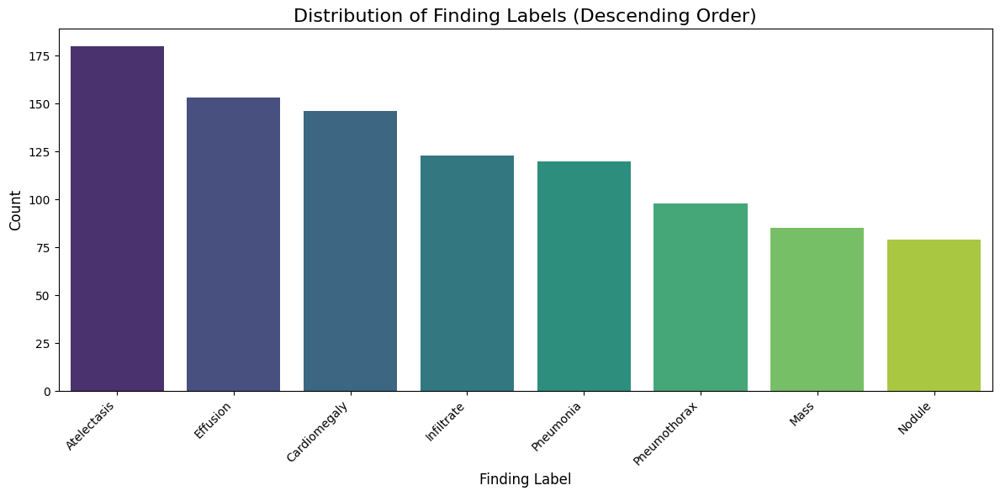

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Get the value counts of 'Finding Label' and sort in descending order
finding_label_counts = df['Finding Label'].value_counts().sort_values(ascending=False)

# Create a bar plot
plt.figure(figsize=(12, 6)) # Adjust figure size as needed
sns.barplot(x=finding_label_counts.index, y=finding_label_counts.values, palette='viridis')
plt.title('Distribution of Finding Labels (Descending Order)', fontsize=16)
plt.xlabel('Finding Label', fontsize=12)
plt.ylabel('Count', fontsize=12)
plt.xticks(rotation=45, ha='right') # Rotate x-axis labels for better readability
plt.tight_layout() # Adjust layout to prevent labels from overlapping
plt.show()

In [ ]:
# prompt: finding label에 무슨 class들이 있는지 알려줘

print(df['Finding Label'].unique())


['Atelectasis' 'Cardiomegaly' 'Effusion' 'Infiltrate' 'Mass' 'Nodule'
 'Pneumonia' 'Pneumothorax']


## 흉부 질환 설명

다음은 데이터셋의 'Finding Label'에 포함된 흉부 질환에 대한 설명입니다.

| 징후 (Finding Label) | 설명                                                                 |
| :------------------- | :------------------------------------------------------------------- |
| Atelectasis          | 폐의 일부 또는 전체가 쭈그러들어 부피가 감소한 상태                  |
| Effusion         | 폐를 둘러싸고 있는 흉강 내에 비정상적으로 액체가 축적된 상태 (흉수)                                |
| Cardiomegaly             | 심장의 크기가 정상보다 커져 있는 상태   |
| Infiltrate           | 폐 실질에 염증성 세포나 체액 등이 스며들어 있는 상태                 |
| Mass                 | 흉부 X선 영상에서 발견되는 3cm 이상의 비교적 큰 덩어리                 |
| Nodule               | 흉부 X선 영상에서 발견되는 3cm 미만의 작은 덩어리                    |
| Pneumonia            | 폐에 염증이 생긴 상태 (주로 감염)                                    |
| Pneumothorax         | 폐를 둘러싸고 있는 흉막강 내에 공기가 비정상적으로 들어가 폐가 찌그러진 상태 |


# Object Detection

In [ ]:
merged_df.head()

,Image Index,Finding Label,x,y,w,h,Image_path
0,00013118_008.png,Atelectasis,225.084746,547.019217,86.779661,79.186441,/content/drive/MyDrive/bio/chest_project/bbox_...
1,00014716_007.png,Atelectasis,686.101695,131.543498,185.491525,313.491525,/content/drive/MyDrive/bio/chest_project/bbox_...
2,00029817_009.png,Atelectasis,221.830508,317.053115,155.118644,216.949153,/content/drive/MyDrive/bio/chest_project/bbox_...
3,00014687_001.png,Atelectasis,726.237288,494.951420,141.016949,55.322034,/content/drive/MyDrive/bio/chest_project/bbox_...
4,00017877_001.png,Atelectasis,660.067797,569.780787,200.677966,78.101695,/content/drive/MyDrive/bio/chest_project/bbox_...


In [ ]:
df = merged_df.copy()

In [ ]:
from enum import Enum
from PIL import Image
import os
import pandas as pd

# 1. Enum 정의
class ChestLabel(Enum):
    Atelectasis = 0
    Effusion = 1
    Cardiomegaly = 2
    Infiltrate = 3
    Pneumonia = 4
    Pneumothorax = 5
    Mass = 6
    Nodule = 7

# 2. 필요한 열만 가져오기
df_yolo = df[['Image Index', 'Finding Label', 'x', 'y', 'w', 'h', 'Image_path']].copy()

# 3. YOLO 형식 바운딩 박스 저장용
yolo_annotations = []

# 4. 이미지 크기 저장용 캐시
image_size_cache = {}

# 5. 각 행에 대해 YOLO 포맷으로 변환
for _, row in df_yolo.iterrows():
    image_path = row["Image_path"]
    if not os.path.exists(image_path):
        continue

    if image_path not in image_size_cache:
        try:
            img = Image.open(image_path)
            width, height = img.size
            image_size_cache[image_path] = (width, height)
        except:
            continue

    width, height = image_size_cache[image_path]

    x_center = (row["x"] + row["w"] / 2) / width
    y_center = (row["y"] + row["h"] / 2) / height
    bbox_width = row["w"] / width
    bbox_height = row["h"] / height

    # 6. Enum으로 라벨 ID 추출 (예외 처리 포함)
    try:
        class_id = ChestLabel[row["Finding Label"]].value
    except KeyError:
        continue  # Enum에 없는 라벨이면 무시

    yolo_annotations.append({
        "image_path": image_path,
        "label": class_id,
        "x_center": x_center,
        "y_center": y_center,
        "bbox_width": bbox_width,
        "bbox_height": bbox_height,
        "image_name": row["Image Index"]
    })

# 7. DataFrame으로 변환
yolo_df = pd.DataFrame(yolo_annotations)


In [ ]:
# # prompt: yolo_df 를 csv 파일로 출력

yolo_df.to_csv(root_path + "/yolo_annotations.csv", index=False)

In [ ]:
yolo_df = pd.read_csv(root_path + "/yolo_annotations.csv")

In [ ]:
# # prompt: root_path + "/yolo_annotations.csv" 값을 가져와

# yolo_annotations_df = pd.read_csv(root_path + "/yolo_annotations.csv")
# print(yolo_annotations_df.head())

                                          image_path  label  x_center  \
0  /content/drive/MyDrive/bio/chest_project/bbox_...      0  0.262182   
1  /content/drive/MyDrive/bio/chest_project/bbox_...      0  0.760593   
2  /content/drive/MyDrive/bio/chest_project/bbox_...      0  0.292373   
3  /content/drive/MyDrive/bio/chest_project/bbox_...      0  0.778072   
4  /content/drive/MyDrive/bio/chest_project/bbox_...      0  0.742585   

   y_center  bbox_width  bbox_height        image_name  
0  0.572864    0.084746     0.077331  00013118_008.png  
1  0.281532    0.181144     0.306144  00014716_007.png  
2  0.415554    0.151483     0.211864  00029817_009.png  
3  0.510364    0.137712     0.054025  00014687_001.png  
4  0.594562    0.195975     0.076271  00017877_001.png  


In [ ]:
from sklearn.model_selection import StratifiedKFold

# Stratified 5-Fold 준비
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Fold 인덱스 추가
yolo_df["fold"] = -1
for fold_idx, (_, val_idx) in enumerate(skf.split(X=yolo_df, y=yolo_df["label"])):
    yolo_df.loc[val_idx, "fold"] = fold_idx

# 1개 fold만 사용해서 train/val 분할 (예: fold 0 → validation)
val_fold = 0
train_df = yolo_df[yolo_df["fold"] != val_fold]
val_df = yolo_df[yolo_df["fold"] == val_fold]

# 이미지 경로만 추출 (YOLO는 이미지 경로만 필요)
train_list = train_df["image_path"].tolist()
val_list = val_df["image_path"].tolist()

# 파일 저장 경로
train_txt_path = root_path+"/data/train.txt"
val_txt_path = root_path+"/data/val.txt"

# 이미지 경로를 텍스트 파일로 저장
with open(train_txt_path, "w") as f:
    for path in train_list:
        f.write(path + "\n")

with open(val_txt_path, "w") as f:
    for path in val_list:
        f.write(path + "\n")

train_txt_path, val_txt_path


('/content/drive/MyDrive/bio/chest_project/data/train.txt',
 '/content/drive/MyDrive/bio/chest_project/data/val.txt')

In [ ]:
# prompt: '/content/drive/MyDrive/bio/chest_project/data/train.txt' 줄 수를 계산

!wc -l '/content/drive/MyDrive/bio/chest_project/data/train.txt'

787 /content/drive/MyDrive/bio/chest_project/data/train.txt


In [ ]:
# prompt: root_path + data/labels/train 의 txt 수 계산

train_labels_path = root_path + '/data/labels/train'

if os.path.exists(train_labels_path):
    txt_files = [f for f in os.listdir(train_labels_path) if f.endswith('.txt')]
    print(f"Number of .txt files in {train_labels_path}: {len(txt_files)}")
else:
    print(f"Directory not found: {train_labels_path}")


Number of .txt files in /content/drive/MyDrive/bio/chest_project/data/labels/train: 716


In [ ]:
import os
import shutil
from tqdm import tqdm

# 정의된 경로
root_path = "/content/drive/MyDrive/bio/chest_project"
data_path = os.path.join(root_path, "data")

# 새로운 디렉토리 구조 생성
for split in ["train", "val"]:
    images_dir = os.path.join(data_path, split, "images")
    labels_dir = os.path.join(data_path, split, "labels")
    os.makedirs(images_dir, exist_ok=True)
    os.makedirs(labels_dir, exist_ok=True)

# train.txt / val.txt 경로
train_txt_path = os.path.join(data_path, "train.txt")
val_txt_path = os.path.join(data_path, "val.txt")

# 이미지 복사 함수
def copy_images(txt_path, dest_dir):
    copied = 0
    with open(txt_path, "r") as f:
        for line in tqdm(f, desc=f"Copying to {dest_dir}"):
            src_path = line.strip()
            if not os.path.exists(src_path):
                print(f"[WARNING] File not found: {src_path}")
                continue
            filename = os.path.basename(src_path)
            dst_path = os.path.join(dest_dir, filename)
            try:
                shutil.copy2(src_path, dst_path)
                copied += 1
            except Exception as e:
                print(f"[ERROR] Could not copy {src_path}: {e}")
    return copied

# 이미지 복사 실행
copied_train = copy_images(train_txt_path, os.path.join(data_path, "train", "images"))
copied_val = copy_images(val_txt_path, os.path.join(data_path, "val", "images"))

copied_train, copied_val


Copying to /content/drive/MyDrive/bio/chest_project/data/train/images: 787it [02:30,  5.22it/s]
Copying to /content/drive/MyDrive/bio/chest_project/data/val/images: 197it [00:51,  3.79it/s]


(787, 197)

In [ ]:
import pandas as pd
import os
import shutil
from tqdm import tqdm
import matplotlib.pyplot as plt

# Load the uploaded yolo_df CSV
csv_path = "/content/drive/MyDrive/bio/chest_project/yolo_annotations.csv"
yolo_df = pd.read_csv(csv_path)

# Paths for new images (already assumed copied) and where labels should go
root_path = "/content/drive/MyDrive/bio/chest_project/data"
splits = ["train", "val"]

# Enum-style label map
label_map = {
    "Atelectasis": 0,
    "Effusion": 1,
    "Cardiomegaly": 2,
    "Infiltrate": 3,
    "Pneumonia": 4,
    "Pneumothorax": 5,
    "Mass": 6,
    "Nodule": 7,
}

# Prepare to create label files for train and val
results = {}

for split in splits:
    images_dir = os.path.join(root_path, split, "images")
    labels_dir = os.path.join(root_path, split, "labels")
    os.makedirs(labels_dir, exist_ok=True)

    image_files = [f for f in os.listdir(images_dir) if f.lower().endswith((".png", ".jpg", ".jpeg"))]
    missing_count = 0
    label_written = 0

    for img_file in tqdm(image_files, desc=f"Processing {split} images"):
        img_name = os.path.splitext(img_file)[0]
        label_path = os.path.join(labels_dir, f"{img_name}.txt")

        # Find all bbox entries for this image
        entries = yolo_df[yolo_df["image_name"] == img_file]
        if entries.empty:
            missing_count += 1
            continue

        with open(label_path, "w") as f:
            for _, row in entries.iterrows():
                label_id = int(row["label"])
                f.write(f"{label_id} {row['x_center']:.6f} {row['y_center']:.6f} {row['bbox_width']:.6f} {row['bbox_height']:.6f}\n")
            label_written += 1

    results[split] = {
        "total_images": len(image_files),
        "labels_written": label_written,
        "missing_labels": missing_count,
    }

pd.DataFrame(results).T


Processing val images: 100%|██████████| 195/195 [00:01<00:00, 127.00it/s]


,total_images,labels_written,missing_labels
train,716,716,0
val,195,195,0


In [ ]:
from enum import Enum
import os
import pandas as pd

# Enum 정의
class ChestLabel(Enum):
    Atelectasis = 0
    Effusion = 1
    Cardiomegaly = 2
    Infiltrate = 3
    Pneumonia = 4
    Pneumothorax = 5
    Mass = 6
    Nodule = 7

# 클래스 이름 리스트 생성
class_names = [label.name for label in ChestLabel]
root_path = "/content/drive/MyDrive/bio/chest_project"
# data.yaml 저장 경로
data_yaml_path = os.path.join(root_path, "data.yaml")

# ✅ 경로를 YOLO가 요구하는 이미지 폴더 경로로 수정
data_yaml_content = f"""\
train: {root_path}/datasets/train/images
val: {root_path}/datasets/val/images
nc: {len(class_names)}
names: {class_names}
"""

# yaml 파일 생성
with open(data_yaml_path, "w") as f:
    f.write(data_yaml_content)

print("✅ data.yaml created at:", data_yaml_path)


✅ data.yaml created at: /content/drive/MyDrive/bio/chest_project/data.yaml


# 학습

In [ ]:
!pip install wandb

In [ ]:
import wandb
import os
from ultralytics import YOLO
from wandb.integration.ultralytics import add_wandb_callback
os.environ["WANDB_API_KEY"] = "35d7152411965fd0aac75a8b2c729d8b0cc29399"
os.environ["WANDB_MODE"] = "online"
os.environ["WANDB_PROJECT"] = "chest-xray-yolo"
os.environ["WANDB_NAME"] = "v8_results_run3"

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


wandb: WARNING This integration is tested and supported for ultralytics v8.0.238 and below.
wandb: WARNING             Please report any issues to https://github.com/wandb/wandb/issues with the tag `yolov8`.


In [ ]:
!wandb login

wandb: Currently logged in as: meto to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


In [ ]:
import ultralytics
ultralytics.checks()

Ultralytics 8.3.156 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (8 CPUs, 51.0 GB RAM, 41.6/235.7 GB disk)


In [ ]:
# YOLOv8s (small) 모델 로드 (pretrained)
model = YOLO('yolov8s.pt')
add_wandb_callback(model, enable_model_checkpointing=True)

YOLO(
  (model): DetectionModel(
    (model): Sequential(
      (0): Conv(
        (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (bn): BatchNorm2d(32, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
      (1): Conv(
        (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (bn): BatchNorm2d(64, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
      (2): C2f(
        (cv1): Conv(
          (conv): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn): BatchNorm2d(64, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
          (act): SiLU(inplace=True)
        )
        (cv2): Conv(
          (conv): Conv2d(96, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn): BatchNorm2d(64, eps=0.001, momentum=0.03, affine=True, track_running_s

In [ ]:

# ✅ Step 1: wandb 로그인
# wandb.login()
# ✅ Step 2: wandb 실험 초기화 (하이퍼파라미터 기록 포함)
wandb.init(
    project="chest-xray-yolo",  # 프로젝트 이름 (없으면 자동 생성됨)
    name="v8_results_run3",     # 원하는 실험 이름
    config={
        "epochs": 200,
        "imgsz": 1024,
        "batch": 16,
        "model": "yolov8s.pt",
    },
)

wandb: Currently logged in as: meto to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


In [ ]:
print(type(model.names), len(model.names))
print(model.names)

<class 'dict'> 80
{0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: 'couch', 58: 'potted plant', 59: 'bed', 60: 'dining table', 61: 'toilet', 62: 'tv', 63: 'laptop', 64: 'mouse', 65: 'remote', 66: 'keyboard', 67: 'cell p

In [ ]:
# 학습 시작
model.train(
    data='/content/drive/MyDrive/bio/chest_project/data.yaml',
    epochs=200,
    imgsz=1024,
    batch=16,
    project='/content/drive/MyDrive/bio/chest_project/chest_yolo',
    name='v8_results'
)

Ultralytics 8.3.156 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/bio/chest_project/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=200, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=1024, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8s.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=v8_results16, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, pl

100%|██████████| 755k/755k [00:00<00:00, 3.13MB/s]

Overriding model.yaml nc=80 with nc=8

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

  9                  -1  1    656896  ultralytics.nn.modules.block.SPPF            [512, 512, 5]                 
 10                  -1  1         0  torch.nn.modules.upsampling.Upsample         [None, 2, 'nearest']          
 11             [-1, 6]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 12                  -1  1    591360  ultralytics.nn.modules.block.C2f             [768, 256, 1]                 
 13                  -1  1         0  torch.nn.modules.upsampling.Upsample         [None, 2, 'nearest']          
 14             [-1, 4]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 15                  -1  1    148224  ultralytics.nn.modules.block.C2f             [384, 128, 1]                 
 16                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
 17            [-1, 12]  1         0  ultralytics.nn.modules.conv.Concat           [1]  

train: Scanning /content/drive/MyDrive/bio/chest_project/datasets/train/labels.cache... 716 images, 0 backgrounds, 0 corrupt: 100%|██████████| 716/716 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.4±0.0 ms, read: 0.6±0.3 MB/s, size: 396.2 KB)


val: Scanning /content/drive/MyDrive/bio/chest_project/datasets/val/labels.cache... 195 images, 0 backgrounds, 0 corrupt: 100%|██████████| 195/195 [00:00<?, ?it/s]


Plotting labels to /content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results16/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000833, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 1024 train, 1024 val
Using 8 dataloader workers
Logging results to /content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results16
Starting training for 200 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/200      8.45G      2.645      17.36      2.716         37       1024: 100%|██████████| 45/45 [00:47<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.25it/s]

                   all        195        233    0.00493     0.0121    0.00403   0.000937
Ultralytics 8.3.156 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)


YOLOv8s summary (fused): 72 layers, 11,156,544 parameters, 0 gradients, 28.6 GFLOPs


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/200      8.34G      2.354      5.072      2.493         18       1024: 100%|██████████| 45/45 [00:26<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.14it/s]

                   all        195        233   0.000907      0.198    0.00104   0.000325


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

wandb: WARNING You are mutating a Table with log_mode='IMMUTABLE' that has been logged already. Subsequent log() calls will have no effect. Set log_mode='MUTABLE' to enable re-logging after mutations


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/200      8.36G      2.354      4.372      2.544         29       1024: 100%|██████████| 45/45 [00:27<00:00,  1.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.08it/s]

                   all        195        233      0.758     0.0524    0.00917    0.00301


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/200      8.36G      2.319      4.153      2.526         21       1024: 100%|██████████| 45/45 [00:27<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.00it/s]

                   all        195        233      0.645     0.0197     0.0116    0.00388


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/200      8.28G      2.268      4.034      2.551         27       1024: 100%|██████████| 45/45 [00:27<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.98it/s]

                   all        195        233      0.918     0.0156     0.0306     0.0106


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/200      8.38G      2.237      3.839      2.469         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.98it/s]

                   all        195        233      0.774     0.0443     0.0329      0.014


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/200      8.35G      2.179      3.835      2.417         24       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.01it/s]

                   all        195        233      0.291      0.098     0.0313     0.0118


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/200      8.38G      2.184      3.654      2.414         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.09it/s]

                   all        195        233      0.679     0.0487     0.0571     0.0186


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/200      8.34G      2.112      3.662      2.361         27       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.04it/s]

                   all        195        233      0.698     0.0454     0.0444     0.0197


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/200       8.4G       2.06      3.546      2.344         25       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.04it/s]

                   all        195        233      0.644     0.0472     0.0642     0.0277


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/200       8.4G      2.062      3.546      2.327         20       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.01it/s]

                   all        195        233      0.521      0.135     0.0996     0.0384


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/200      8.33G      2.066      3.505      2.345         26       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.09it/s]

                   all        195        233      0.692     0.0477     0.0554     0.0243


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/200      8.35G      1.987       3.44      2.263         28       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.02it/s]

                   all        195        233      0.709      0.103     0.0779     0.0287


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/200      8.38G      1.999      3.445      2.281         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.03it/s]

                   all        195        233      0.583       0.15     0.0922     0.0443


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/200      8.37G       1.96      3.386      2.272         25       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.09it/s]

                   all        195        233      0.795      0.073     0.0729     0.0248


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/200      8.36G      1.959      3.294      2.236         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.03it/s]

                   all        195        233      0.373      0.141      0.088     0.0438


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/200      8.34G      1.968      3.293      2.243         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.02it/s]

                   all        195        233      0.337      0.157      0.111     0.0541


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/200       8.4G      1.976      3.248      2.234         36       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.03it/s]

                   all        195        233      0.445      0.107     0.0642     0.0286


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/200      8.34G      1.878      3.218      2.165         19       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.09it/s]

                   all        195        233      0.818     0.0866     0.0987     0.0494


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/200      8.38G      1.925      3.246      2.203         21       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.02it/s]

                   all        195        233      0.818     0.0808     0.0935     0.0414


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/200      8.36G      1.904      3.244      2.199         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.02it/s]

                   all        195        233      0.423      0.202      0.118     0.0571


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/200      8.38G      1.897      3.157      2.211         25       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.11it/s]

                   all        195        233      0.317      0.119     0.0629     0.0277


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/200       8.4G      1.859      3.115      2.154         21       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.03it/s]

                   all        195        233      0.364       0.14      0.111     0.0478


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/200      8.38G      1.831      3.055      2.126         25       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.04it/s]

                   all        195        233      0.485      0.126     0.0979     0.0436


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/200      8.35G      1.851      3.129      2.152         21       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.03it/s]

                   all        195        233      0.453      0.119     0.0876     0.0439


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/200      8.35G      1.834      3.083      2.157         33       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.08it/s]

                   all        195        233      0.351      0.175      0.109     0.0512


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/200      8.38G      1.836      3.103      2.158         23       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.03it/s]

                   all        195        233      0.685      0.144      0.129     0.0614


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/200      8.37G      1.823      3.014      2.114         32       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.03it/s]

                   all        195        233      0.125      0.144      0.109     0.0526


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/200      8.33G      1.829      2.951      2.146         20       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.10it/s]

                   all        195        233      0.238      0.147      0.101      0.044


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/200      8.39G      1.775      2.926      2.083         25       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.04it/s]

                   all        195        233       0.28      0.139      0.113     0.0574


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/200      8.37G      1.754      2.931      2.068         23       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.04it/s]

                   all        195        233      0.227      0.184      0.139     0.0687


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/200      8.37G      1.789      2.895      2.095         24       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233       0.73      0.168      0.137     0.0641


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/200      8.29G      1.755      2.793      2.065         29       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.09it/s]

                   all        195        233      0.458      0.185      0.153     0.0749


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/200      8.38G      1.703      2.791       2.05         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.01it/s]

                   all        195        233      0.245      0.221      0.134     0.0669


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/200      8.38G      1.719      2.749      2.054         25       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.04it/s]

                   all        195        233      0.253      0.189      0.135     0.0531


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/200      8.38G      1.715      2.709      2.059         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.09it/s]

                   all        195        233      0.213      0.197      0.141     0.0668


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/200      8.35G      1.682      2.754      2.036         21       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.04it/s]

                   all        195        233      0.167      0.212      0.138     0.0595


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/200       8.4G      1.703      2.709      2.019         25       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233       0.13      0.203      0.163     0.0655


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/200      8.37G      1.708      2.742      2.039         29       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.354      0.177      0.148     0.0678


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/200      8.31G      1.702      2.717      2.046         21       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.08it/s]

                   all        195        233      0.211      0.186      0.149     0.0683


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/200      8.34G      1.683      2.641      2.015         19       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.02it/s]

                   all        195        233      0.145      0.236       0.18     0.0825


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/200      8.41G      1.671       2.66      1.984         34       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.04it/s]

                   all        195        233      0.226      0.191      0.145     0.0596


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/200      8.36G      1.685      2.647      2.032         21       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.11it/s]

                   all        195        233      0.332      0.189      0.151     0.0627


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/200      8.38G      1.634      2.569      1.999         29       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233       0.25       0.19      0.155      0.071


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/200      8.35G      1.645        2.6      1.977         21       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.03it/s]

                   all        195        233      0.169      0.226      0.173     0.0751


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/200      8.38G      1.602      2.548      1.956         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.195      0.219       0.16     0.0739


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/200      8.31G      1.604      2.521      1.968         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.09it/s]

                   all        195        233      0.146      0.168      0.135     0.0653


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/200      8.37G      1.587      2.539      1.963         29       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.172      0.225       0.17     0.0854


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/200      8.34G      1.595      2.508       1.95         15       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.207      0.204      0.169     0.0865


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/200      8.39G      1.562      2.383      1.907         21       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.13it/s]

                   all        195        233      0.206      0.206      0.166     0.0857


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/200      8.38G      1.576      2.357      1.893         29       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.04it/s]

                   all        195        233      0.182      0.215      0.138     0.0568


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/200      8.36G      1.597      2.444      1.944         28       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.226      0.257      0.178     0.0849


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/200      8.35G      1.511      2.271      1.875         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.468       0.25      0.194     0.0916


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/200      8.35G      1.587      2.387      1.956         29       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.08it/s]

                   all        195        233      0.268      0.199      0.177     0.0843


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/200      8.38G      1.558      2.365      1.902         17       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.04it/s]

                   all        195        233      0.176      0.194      0.157     0.0832


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/200      8.36G      1.573      2.297      1.914         19       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.203      0.245      0.192     0.0931


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/200      8.34G      1.537      2.297      1.874         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.11it/s]

                   all        195        233      0.263      0.215      0.162      0.078


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/200      8.39G      1.525       2.23      1.877         26       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.234      0.206      0.162     0.0777


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/200      8.38G      1.453       2.11      1.838         25       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.261      0.253      0.217      0.114


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/200      8.38G      1.479      2.111      1.842         28       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.213       0.24      0.178     0.0924


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/200      8.29G      1.515      2.227      1.881         31       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.10it/s]

                   all        195        233      0.262      0.204      0.197     0.0981


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/200       8.4G      1.491       2.12      1.836         20       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.242      0.274      0.194      0.103


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/200      8.38G       1.46      2.134      1.798         21       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.02it/s]

                   all        195        233      0.259      0.236        0.2      0.107


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/200      8.38G      1.458      2.111      1.822         25       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.13it/s]

                   all        195        233      0.209      0.293      0.203      0.108


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/200      8.34G      1.442      2.094      1.796         24       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.256      0.295       0.24      0.127


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/200      8.38G       1.41      2.026      1.775         32       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.246      0.282      0.223      0.108


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/200      8.38G      1.413      2.069      1.796         24       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.03it/s]

                   all        195        233      0.206      0.299      0.181     0.0902


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/200      8.32G       1.42       2.03      1.789         23       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.11it/s]

                   all        195        233      0.295       0.28      0.221      0.116


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/200      8.35G      1.402      1.979      1.791         17       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.04it/s]

                   all        195        233      0.397      0.209      0.203      0.105


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/200      8.39G      1.375      1.995      1.759         21       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.271      0.283      0.251      0.123


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/200      8.37G      1.392      1.993      1.802         27       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.13it/s]

                   all        195        233      0.274      0.294      0.226      0.118


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/200      8.39G      1.421      2.045        1.8         20       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.307      0.306      0.232      0.133


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/200      8.34G      1.423      2.015      1.798         19       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.278      0.274      0.221      0.119


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/200      8.38G      1.368      1.887      1.726         18       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.294      0.293      0.256      0.154


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/200      8.32G      1.339      1.879      1.721         20       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.09it/s]

                   all        195        233      0.304      0.301      0.246      0.131


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/200      8.38G      1.317      1.856      1.702         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.281       0.29      0.254      0.144


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/200      8.35G      1.311      1.841      1.706         27       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.353      0.296      0.231      0.127


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/200       8.4G      1.302       1.76      1.665         19       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.11it/s]

                   all        195        233      0.335      0.243       0.22      0.118


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/200      8.38G      1.328      1.889      1.733         19       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.338      0.293      0.261      0.139


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/200       9.5G      1.274      1.802      1.691         21       1024: 100%|██████████| 45/45 [00:27<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.392      0.304      0.302      0.168


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/200      8.35G      1.315      1.773      1.685         26       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.326      0.283      0.275       0.16


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/200      8.34G      1.251      1.669       1.67         19       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.11it/s]

                   all        195        233      0.332      0.318      0.297      0.177


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/200      8.37G      1.262       1.71      1.648         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.372      0.315      0.298      0.175


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/200      8.39G      1.248       1.67      1.631         17       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.02it/s]

                   all        195        233      0.317      0.285      0.261      0.153


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/200      8.36G      1.221      1.647       1.62         26       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.13it/s]

                   all        195        233      0.412      0.302      0.316      0.186


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/200      8.41G      1.247      1.623      1.637         27       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.04it/s]

                   all        195        233      0.471      0.265        0.3      0.174


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/200      8.38G      1.208      1.624      1.623         24       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.372      0.347        0.3      0.172


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/200      8.36G      1.236      1.653      1.644         19       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.332      0.344      0.288      0.154


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/200       8.3G      1.207      1.598      1.598         25       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.09it/s]

                   all        195        233      0.367      0.292      0.292       0.18


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/200      8.39G      1.239      1.638      1.637         17       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.333      0.332      0.299      0.175


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/200      8.37G      1.228      1.627      1.614         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.452       0.31      0.302      0.177


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/200      8.38G      1.207      1.643      1.617         27       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        195        233      0.344      0.357      0.296      0.167


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/200      8.35G      1.154      1.505      1.547         18       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.368      0.357      0.316      0.184


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/200      8.39G      1.191      1.563      1.577         24       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.04it/s]

                   all        195        233      0.384      0.358      0.315      0.185


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/200      8.37G      1.204      1.569      1.593         17       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.379       0.34      0.312      0.184


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/200      8.32G      1.183      1.575      1.599         28       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        195        233      0.412       0.35      0.299      0.174


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/200      8.36G      1.144      1.561      1.549         28       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        195        233      0.526      0.305      0.313      0.192


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/200      8.38G      1.144      1.495      1.559         19       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.419      0.308      0.329      0.195


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/200      8.37G      1.161      1.482      1.592         24       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        195        233      0.391      0.384      0.336      0.206


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/200      8.38G      1.133      1.426      1.541         25       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.445      0.308      0.286      0.168


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/200      8.35G      1.143      1.456      1.539         30       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.461      0.282      0.312      0.198


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/200      8.39G      1.112      1.399       1.52         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.08it/s]

                   all        195        233      0.477       0.31      0.346      0.221


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/200      8.32G      1.103      1.418      1.536         20       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        195        233      0.437      0.345      0.333      0.213


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/200      8.37G       1.11        1.4      1.519         26       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.476      0.331      0.359      0.225


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/200      8.34G      1.094      1.418      1.505         20       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.439      0.299      0.318      0.197


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/200      8.38G      1.075      1.347      1.503         25       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.11it/s]

                   all        195        233      0.414      0.285      0.313      0.191


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/200      8.36G      1.079      1.362      1.473         24       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233       0.36      0.349      0.308      0.194


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/200      8.38G      1.099      1.386      1.515         16       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        195        233      0.434      0.332      0.352       0.23


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/200      8.35G      1.097      1.398      1.506         17       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233       0.44      0.337       0.34      0.221


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/200      8.35G      1.063       1.35      1.478         23       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.10it/s]

                   all        195        233      0.441      0.344       0.35      0.237


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/200      8.37G      1.057       1.29      1.466         24       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.673      0.309      0.362      0.236


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/200      8.38G      1.011      1.246      1.423         24       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.04it/s]

                   all        195        233      0.405      0.392      0.353      0.228


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/200      8.35G       1.02      1.303       1.46         20       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.11it/s]

                   all        195        233      0.403      0.332      0.337      0.216


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/200      8.38G      1.072      1.378       1.51         24       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.516      0.347      0.353      0.233


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/200      8.36G      1.034      1.279      1.464         29       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        195        233      0.458      0.357      0.352      0.227


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/200      8.38G      1.013      1.212      1.419         21       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.468      0.346      0.334      0.214


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/200       8.3G       1.02      1.278      1.442         21       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        195        233      0.589      0.319      0.356      0.232


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/200      8.38G      1.004      1.227      1.421         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233        0.5      0.374      0.341      0.223


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/200      8.39G     0.9747      1.199      1.399         35       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.573      0.299      0.372      0.249


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/200      8.37G     0.9718      1.153      1.411         18       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        195        233      0.495      0.384      0.384      0.247


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    121/200      8.36G     0.9607      1.155      1.398         25       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.602      0.301      0.356      0.231


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    122/200      8.38G     0.9501      1.129      1.383         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.488      0.344      0.351      0.234


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    123/200      8.38G     0.9702      1.167      1.401         32       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.549      0.328      0.355      0.241


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    124/200      8.33G     0.9669      1.194      1.389         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.10it/s]

                   all        195        233      0.456      0.356      0.349      0.234


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    125/200      8.37G     0.9351      1.127      1.366         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.425      0.375       0.37       0.25


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    126/200      8.38G     0.9359      1.125      1.371         21       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.04it/s]

                   all        195        233      0.627      0.357      0.381      0.245


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    127/200      8.37G     0.9195      1.094      1.363         25       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        195        233      0.608      0.359       0.38      0.261


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    128/200      8.37G     0.9226       1.13      1.377         24       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.544       0.34       0.37      0.255


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    129/200      8.35G     0.8978      1.076      1.337         36       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.04it/s]

                   all        195        233       0.58      0.305      0.366      0.253


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    130/200       8.4G     0.9213      1.109      1.354         28       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        195        233       0.51      0.387      0.375      0.258


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    131/200       8.3G     0.9382      1.121      1.374         25       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.11it/s]

                   all        195        233      0.564      0.313       0.35      0.241


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    132/200      8.39G     0.9171      1.086      1.342         29       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.517      0.363      0.366      0.255


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    133/200      8.35G     0.8807       1.07      1.325         30       1024: 100%|██████████| 45/45 [00:27<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        195        233       0.51      0.384      0.373      0.261


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    134/200       8.4G     0.8899      1.036      1.331         21       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        195        233      0.608      0.299      0.381      0.273


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    135/200      8.37G      0.888      1.033       1.33         15       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.525      0.353      0.381      0.266


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    136/200      8.39G     0.8787       1.02       1.34         25       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        195        233      0.681      0.352      0.409      0.287


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    137/200      8.35G     0.8652      1.036      1.323         18       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233        0.6      0.379      0.401      0.281


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    138/200      8.33G     0.8811      1.044      1.325         23       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.10it/s]

                   all        195        233      0.579      0.351      0.392      0.272


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    139/200      8.36G     0.8526      1.008      1.316         35       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.04it/s]

                   all        195        233      0.495      0.404      0.377      0.267


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    140/200      8.38G     0.8194     0.9687      1.274         27       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        195        233      0.459      0.373      0.383      0.275


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    141/200      8.35G     0.8315     0.9718       1.29         26       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        195        233      0.551      0.362      0.385      0.266


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    142/200       8.4G     0.8575      1.018       1.29         34       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.08it/s]

                   all        195        233      0.553      0.351      0.386      0.277


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    143/200      8.38G     0.8332     0.9718      1.288         24       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.03it/s]

                   all        195        233      0.525      0.364      0.388       0.28


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    144/200      8.36G     0.8412     0.9762      1.284         25       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.08it/s]

                   all        195        233      0.549      0.317      0.376      0.272


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    145/200      8.29G     0.8041     0.9126      1.256         33       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.10it/s]

                   all        195        233      0.594      0.371      0.399      0.284


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    146/200       8.4G     0.8313     0.9742      1.292         35       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        195        233      0.638      0.368      0.396      0.274


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    147/200      8.37G     0.8532     0.9633      1.313         28       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.03it/s]

                   all        195        233      0.569      0.369      0.394      0.284


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    148/200      8.36G     0.8208     0.9592      1.268         20       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        195        233      0.569      0.346      0.392      0.282


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    149/200      8.36G      0.823     0.9551      1.274         29       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.04it/s]

                   all        195        233      0.625      0.359       0.39      0.284


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    150/200       8.4G     0.7974     0.9374       1.25         28       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.684       0.32      0.386      0.289


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    151/200      8.39G     0.8492      1.013      1.299         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.584      0.358      0.385      0.288


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    152/200      8.32G     0.8187     0.9353      1.294         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        195        233       0.57      0.339       0.39      0.285


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    153/200      8.35G      0.806     0.9591      1.275         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.628      0.377      0.398      0.287


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    154/200      8.39G     0.7936     0.9171      1.255         29       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.665      0.375      0.391      0.283


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    155/200      8.37G     0.7953     0.9239      1.247         24       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.13it/s]

                   all        195        233      0.605      0.338      0.382      0.277


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    156/200      8.38G     0.7931     0.8991      1.249         18       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        195        233      0.608      0.352      0.392      0.292


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    157/200      8.34G     0.8116     0.9595      1.256         26       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.654      0.341        0.4      0.296


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    158/200      8.41G     0.7807     0.8926      1.256         20       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        195        233      0.643      0.352      0.409      0.303


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    159/200       8.3G     0.7639     0.8941      1.229         24       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.10it/s]

                   all        195        233      0.672      0.348        0.4      0.295


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    160/200      8.36G     0.7702     0.9115       1.23         19       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.606      0.343      0.394       0.29


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    161/200      8.34G     0.7417     0.8622      1.209         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        195        233      0.646      0.361      0.401      0.299


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    162/200      8.39G     0.7325     0.8484       1.21         29       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        195        233      0.695      0.347      0.407      0.299


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    163/200      8.36G     0.7544     0.8396      1.222         23       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.08it/s]

                   all        195        233      0.577      0.384        0.4      0.295


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    164/200      8.37G     0.7684     0.9177      1.227         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.579      0.371      0.393      0.289


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    165/200      8.35G     0.7469     0.8761      1.209         18       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.526       0.38      0.404      0.298


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    166/200      8.33G     0.7499     0.8638      1.225         18       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.11it/s]

                   all        195        233        0.7      0.338      0.397      0.293


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    167/200      8.37G      0.701     0.8003      1.175         29       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        195        233      0.548      0.375      0.402      0.298


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    168/200      8.38G     0.7173     0.8341       1.19         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.561      0.359      0.412       0.31


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    169/200      8.37G     0.7361      0.823       1.19         17       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.14it/s]

                   all        195        233       0.58       0.35      0.397      0.303


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    170/200      8.38G     0.7317     0.8413      1.196         19       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.608      0.364      0.404      0.313


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    171/200      8.37G     0.7214     0.8274      1.187         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        195        233      0.697      0.337      0.411      0.314


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    172/200      8.39G     0.7087     0.8203      1.195         20       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        195        233      0.545      0.385       0.41       0.31


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    173/200      8.28G     0.6939     0.8044      1.179         21       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        195        233      0.515      0.368      0.412      0.309


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    174/200      8.39G     0.7138     0.8105      1.201         17       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        195        233      0.601      0.353        0.4      0.306


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    175/200      8.38G     0.7051     0.8016      1.183         28       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233       0.62      0.362      0.409       0.31


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    176/200      8.39G     0.6788     0.7475      1.159         26       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.14it/s]

                   all        195        233      0.686      0.354      0.412      0.312


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    177/200      8.36G     0.6936     0.7985      1.181         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.675      0.361      0.421      0.317


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    178/200      8.39G     0.6918     0.7994      1.184         19       1024: 100%|██████████| 45/45 [00:27<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233      0.596      0.368      0.413      0.311


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    179/200      8.39G     0.6836     0.7781      1.168         20       1024: 100%|██████████| 45/45 [00:27<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.09it/s]

                   all        195        233      0.632      0.378      0.416      0.314


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    180/200       8.3G     0.6819     0.7822      1.189         27       1024: 100%|██████████| 45/45 [00:28<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.14it/s]

                   all        195        233      0.688      0.338       0.41      0.314


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    181/200      8.34G     0.6583     0.7393      1.147         20       1024: 100%|██████████| 45/45 [00:27<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.05it/s]

                   all        195        233       0.54      0.389      0.409      0.317


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    182/200      8.41G     0.6727     0.7806      1.169         29       1024: 100%|██████████| 45/45 [00:27<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        195        233      0.635      0.355      0.408      0.313


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    183/200      8.39G      0.694     0.7901      1.182         25       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        195        233      0.625       0.37      0.418      0.323


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    184/200      8.39G     0.6936     0.7788      1.171         24       1024: 100%|██████████| 45/45 [00:27<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.576      0.387      0.418      0.315


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    185/200      8.35G     0.6556     0.7517      1.154         24       1024: 100%|██████████| 45/45 [00:27<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233       0.74      0.365      0.415      0.316


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    186/200       8.4G     0.6634     0.7526      1.157         24       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.09it/s]

                   all        195        233      0.615      0.373      0.409      0.318


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    187/200      8.33G     0.6646     0.7663      1.158         21       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        195        233      0.671      0.372      0.411      0.318


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    188/200      8.39G     0.6461     0.7481      1.151         17       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.08it/s]

                   all        195        233       0.51      0.378      0.419      0.324


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    189/200      8.37G     0.6692     0.7817      1.163         22       1024: 100%|██████████| 45/45 [00:27<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.08it/s]

                   all        195        233      0.567       0.38      0.416      0.325


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    190/200      8.39G       0.64     0.7626      1.147         19       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        195        233      0.548      0.375      0.416      0.326


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    191/200      8.38G     0.5905     0.5708      1.148         13       1024: 100%|██████████| 45/45 [00:29<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.606      0.374      0.411      0.319


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    192/200      8.37G     0.5675     0.5328      1.113         14       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.697      0.361      0.409      0.318


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    193/200      8.35G     0.5643     0.5291      1.121         14       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.677      0.364      0.409      0.319


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    194/200      8.32G     0.5413     0.5042      1.101         15       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        195        233      0.674      0.347      0.409      0.322


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    195/200      8.37G      0.526     0.4853      1.092         12       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.681       0.34      0.407      0.323


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    196/200      8.37G      0.536     0.5091      1.096         13       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.649      0.355      0.407      0.325


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    197/200      8.35G     0.5263     0.5017      1.095         13       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        195        233      0.739      0.341      0.407      0.324


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    198/200      8.39G     0.5234     0.4893      1.086         13       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        195        233      0.585      0.384      0.412      0.325


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    199/200      8.38G     0.5285     0.4974      1.098         17       1024: 100%|██████████| 45/45 [00:27<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233       0.67       0.36      0.413      0.324


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    200/200      8.38G     0.5117     0.4811       1.08         14       1024: 100%|██████████| 45/45 [00:27<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        195        233      0.694      0.367      0.415      0.323


Generating Visualizations for batch-1/1:   0%|          | 0/3 [00:00<?, ?it/s]

Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]


200 epochs completed in 3.005 hours.
Optimizer stripped from /content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results16/weights/last.pt, 22.6MB
Optimizer stripped from /content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results16/weights/best.pt, 22.6MB

Validating /content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results16/weights/best.pt...
Ultralytics 8.3.156 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,128,680 parameters, 0 gradients, 28.5 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.87it/s]


                   all        195        233      0.552      0.374      0.414      0.325
           Atelectasis         41         41      0.403       0.22      0.261      0.218
              Effusion         45         45      0.556      0.533       0.56      0.479
          Cardiomegaly         31         31      0.682      0.516      0.659      0.437
            Infiltrate         35         35      0.719      0.586      0.627       0.54
             Pneumonia         28         28      0.558      0.357      0.411      0.315
          Pneumothorax         19         19      0.598      0.157      0.162      0.109
                  Mass         18         18      0.661        0.5      0.568      0.468
                Nodule         16         16      0.243      0.121     0.0662     0.0324


Generating Visualizations for batch-1/1:   0%|          | 0/32 [00:00<?, ?it/s]

Speed: 0.5ms preprocess, 12.3ms inference, 0.0ms loss, 2.6ms postprocess per image
Results saved to /content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results16


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7a11c81be5d0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,

In [ ]:
print(type(model.names), len(model.names))
print(model.names)

<class 'dict'> 8
{0: 'Atelectasis', 1: 'Effusion', 2: 'Cardiomegaly', 3: 'Infiltrate', 4: 'Pneumonia', 5: 'Pneumothorax', 6: 'Mass', 7: 'Nodule'}


In [ ]:
# Function to get class names from model.names
def get_class_name(class_id, model_names):
    """
    Maps a class ID to its corresponding name using the model.names dictionary.

    Args:
        class_id (int): The class ID from the label file.
        model_names (dict): The dictionary from the YOLO model mapping IDs to names.

    Returns:
        str or None: The class name if found, None otherwise.
    """
    return model_names.get(class_id)

# Path to the label file
label_file_path = '/content/drive/MyDrive/bio/chest_project/datasets/train/labels/00000032_037.txt'

# Check if the model object and its names are available
if 'model' in globals() and hasattr(model, 'names'):
    model_names = model.names

    # Read the label file line by line
    try:
        with open(label_file_path, 'r') as f:
            print(f"Labels for {os.path.basename(label_file_path)}:")
            for line in f:
                # Split the line by spaces
                parts = line.strip().split()
                if parts:
                    try:
                        # The first part is the class ID
                        class_id = int(parts[0])
                        # Get the class name using the model.names
                        class_name = get_class_name(class_id, model_names)
                        if class_name:
                            print(f"  Class ID: {class_id}, Class Name: {class_name}")
                        else:
                            print(f"  Class ID: {class_id} - Name not found in model.names")
                    except ValueError:
                        print(f"  Skipping line due to invalid format: {line.strip()}")
    except FileNotFoundError:
        print(f"Error: Label file not found at {label_file_path}")
    except Exception as e:
        print(f"An error occurred while reading the label file: {e}")
else:
    print("Error: YOLO 'model' object or 'model.names' is not available. Please ensure the model is loaded.")


Labels for 00000032_037.txt:
  Class ID: 3, Class Name: Infiltrate


In [ ]:
# 학습된 모델 로드
model = YOLO('/content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results16/weights/best.pt')

# 이미지 하나에 대해 추론
results = model('/content/drive/MyDrive/bio/chest_project/datasets/train/images/00000032_037.png', save=True)



image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/train/images/00000032_037.png: 1024x1024 1 Infiltrate, 32.7ms
Speed: 4.2ms preprocess, 32.7ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)
Results saved to runs/detect/predict6


In [ ]:
# 학습된 모델 로드
model = YOLO('/content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results9/weights/best.pt')

# 이미지 하나에 대해 추론
results = model('/content/drive/MyDrive/bio/chest_project/datasets/train/images/00000032_037.png', save=True)


In [ ]:
# prompt: /content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results9/weights/best.pt를 이용해서 inference해봐

# Load the trained model
model = YOLO('/content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results9/weights/best.pt')

# Path to the image you want to use for inference
image_path = '/content/drive/MyDrive/bio/chest_project/datasets/val/images/00000211_041.png'

# Perform inference
results = model(image_path)

# Process results
# You can iterate through the results object to access detection information
for r in results:
    # Access bounding boxes, classes, and scores
    boxes = r.boxes  # Boxes object for bounding box outputs
    masks = r.masks  # Masks object for segmentation masks outputs
    probs = r.probs  # Class probabilities for classification outputs

    # Print information (example)
    print(f"Image: {r.path}")
    print(f"Number of detections: {len(boxes)}")
    if len(boxes) > 0:
        print("Detections:")
        for box in boxes:
            class_id = int(box.cls)
            label = model.names[class_id]
            confidence = float(box.conf)
            bbox = box.xyxy[0].tolist()  # x1, y1, x2, y2 format
            print(f"  - Label: {label}, Confidence: {confidence:.2f}, Bbox: {bbox}")

# Optional: Save the result image with detections drawn
# The `save=True` argument in the initial inference call already saves the image
# to the 'runs/detect' directory within your project path.
# You can specify a different save directory if needed:
# results = model(image_path, save=True, project='/content/drive/MyDrive/bio/chest_project/inference_results')

print("\nInference complete. Results are available in the 'results' variable.")
# If save=True was used, check the 'runs/detect' directory within your project path for saved images.



image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00000211_041.png: 1024x1024 1 Cardiomegaly, 32.7ms
Speed: 4.1ms preprocess, 32.7ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)
Image: /content/drive/MyDrive/bio/chest_project/datasets/val/images/00000211_041.png
Number of detections: 1
Detections:
  - Label: Cardiomegaly, Confidence: 0.43, Bbox: [220.2280731201172, 397.2225646972656, 720.1333618164062, 804.2813720703125]

Inference complete. Results are available in the 'results' variable.



image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00000211_041.png: 1024x1024 1 Cardiomegaly, 32.8ms
Speed: 4.4ms preprocess, 32.8ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


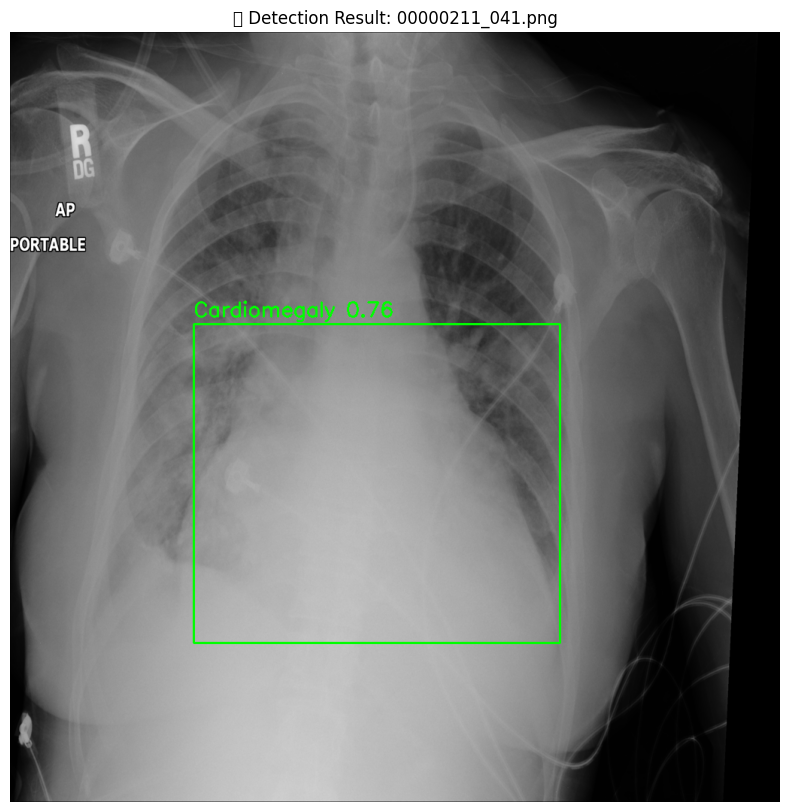

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
from ultralytics import YOLO

# 모델 로드
model = YOLO('/content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results10/weights/best.pt')

# 이미지 경로 설정
image_path = '/content/drive/MyDrive/bio/chest_project/datasets/val/images/00000211_041.png'
image_name = os.path.basename(image_path)

# 추론 수행
results = model(image_path)

# 이미지 로드 (OpenCV용 RGB -> BGR 변환)
img = Image.open(image_path).convert("RGB")
img_cv = np.array(img)
img_cv = cv2.cvtColor(img_cv, cv2.COLOR_RGB2BGR)

# 결과에서 감지 정보 추출
r = results[0]
boxes = r.boxes

# 박스와 라벨 그리기
for box in boxes:
    class_id = int(box.cls)
    label = model.names[class_id]
    confidence = float(box.conf)
    x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())

    # 바운딩 박스와 라벨 추가
    cv2.rectangle(img_cv, (x1, y1), (x2, y2), (0, 255, 0), 2)
    cv2.putText(
        img_cv,
        f"{label} {confidence:.2f}",
        (x1, y1 - 10),
        cv2.FONT_HERSHEY_SIMPLEX,
        0.9,
        (0, 255, 0),
        2
    )

# 시각화
plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(img_cv, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.title(f"🔍 Detection Result: {image_name}")
plt.show()



image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00000211_041.png: 1024x1024 (no detections), 32.7ms
Speed: 4.2ms preprocess, 32.7ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)


/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


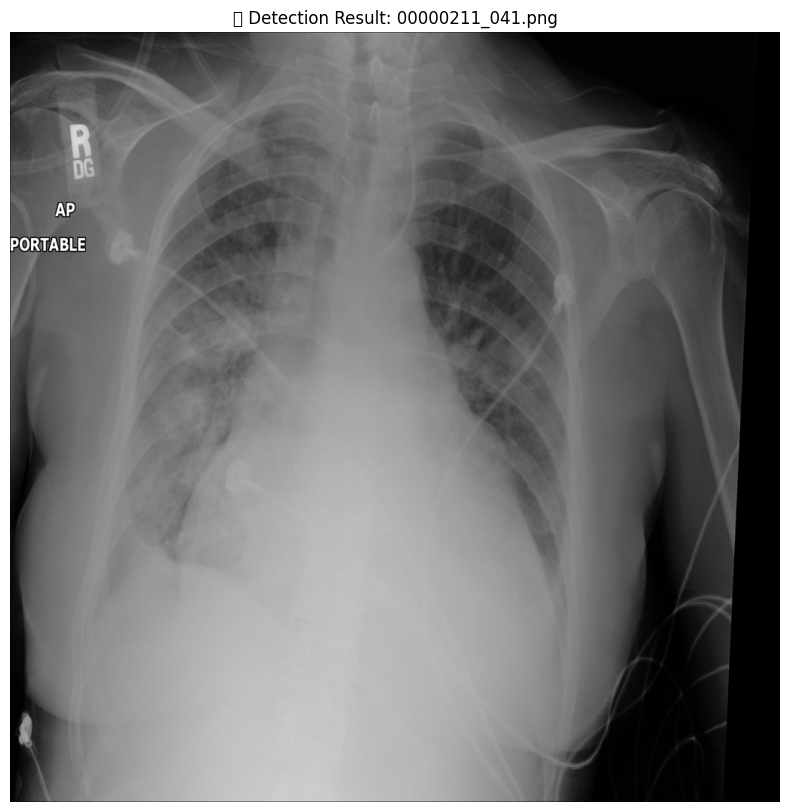

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
from ultralytics import YOLO

# 모델 로드
model = YOLO('/content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results16/weights/best.pt')

# 이미지 경로 설정
image_path = '/content/drive/MyDrive/bio/chest_project/datasets/val/images/00000211_041.png'
image_name = os.path.basename(image_path)

# 추론 수행
results = model(image_path)

# 이미지 로드 (OpenCV용 RGB -> BGR 변환)
img = Image.open(image_path).convert("RGB")
img_cv = np.array(img)
img_cv = cv2.cvtColor(img_cv, cv2.COLOR_RGB2BGR)

# 결과에서 감지 정보 추출
r = results[0]
boxes = r.boxes

# 박스와 라벨 그리기
for box in boxes:
    class_id = int(box.cls)
    label = model.names[class_id]
    confidence = float(box.conf)
    x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())

    # 바운딩 박스와 라벨 추가
    cv2.rectangle(img_cv, (x1, y1), (x2, y2), (0, 255, 0), 2)
    cv2.putText(
        img_cv,
        f"{label} {confidence:.2f}",
        (x1, y1 - 10),
        cv2.FONT_HERSHEY_SIMPLEX,
        0.9,
        (0, 255, 0),
        2
    )

# 시각화
plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(img_cv, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.title(f"🔍 Detection Result: {image_name}")
plt.show()


In [ ]:
# prompt: /content/drive/MyDrive/bio/chest_project/datasets/val/images/00003391_001.png 에 매칭되는 label을 찾아봐

# 주어진 이미지 경로
target_image_path = '/content/drive/MyDrive/bio/chest_project/datasets/val/images/00000211_041.png'

# 파일 이름만 추출 (확장자 포함)
target_image_name = os.path.basename(target_image_path)

# yolo_df에서 해당 이미지 이름을 가진 행 찾기
# yolo_df는 'image_name' 열에 파일 이름 (예: '00003391_001.png')을 가지고 있습니다.
matching_labels_df = yolo_df[yolo_df['image_name'] == target_image_name]
matching_labels_df




,image_path,label,x_center,y_center,bbox_width,bbox_height,image_name
165,/content/drive/MyDrive/bio/chest_project/bbox_...,2,0.46875,0.617355,0.5,0.420551,00000211_041.png


In [ ]:
from enum import Enum

# Enum 정의
class ChestLabel(Enum):
    Atelectasis = 0
    Effusion = 1
    Cardiomegaly = 2
    Infiltrate = 3
    Pneumonia = 4
    Pneumothorax = 5
    Mass = 6
    Nodule = 7

# 첫 번째 매칭 결과의 label 값을 enum으로 변환
numeric_label = matching_labels_df.iloc[0]['label']
disease_name = ChestLabel(numeric_label).name

print(f"🔍 해당 이미지의 질병 라벨: {disease_name}")


🔍 해당 이미지의 질병 라벨: Cardiomegaly


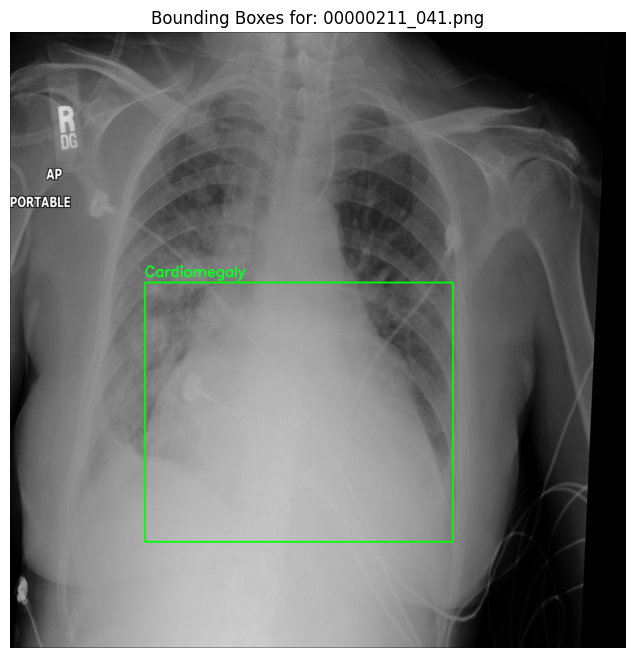

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
from PIL import Image
import pandas as pd
from enum import Enum
import numpy as np

# Enum 정의
class ChestLabel(Enum):
    Atelectasis = 0
    Effusion = 1
    Cardiomegaly = 2
    Infiltrate = 3
    Pneumonia = 4
    Pneumothorax = 5
    Mass = 6
    Nodule = 7

# 주어진 이미지 경로
target_image_path = '/content/drive/MyDrive/bio/chest_project/datasets/val/images/00000211_041.png'
target_image_name = os.path.basename(target_image_path)

# 매칭되는 라벨 데이터 찾기
matching_labels_df = yolo_df[yolo_df['image_name'] == target_image_name]

# 이미지 로드
img = Image.open(target_image_path)
img = img.convert("RGB")
img_cv = cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR)
h, w = img_cv.shape[:2]

# 박스 그리기
for _, row in matching_labels_df.iterrows():
    label_idx = int(row['label'])
    label_name = ChestLabel(label_idx).name

    # YOLO bbox -> pixel 좌표 변환
    xc = row['x_center'] * w
    yc = row['y_center'] * h
    bw = row['bbox_width'] * w
    bh = row['bbox_height'] * h

    x1 = int(xc - bw / 2)
    y1 = int(yc - bh / 2)
    x2 = int(xc + bw / 2)
    y2 = int(yc + bh / 2)

    # 박스와 라벨 텍스트 그리기
    cv2.rectangle(img_cv, (x1, y1), (x2, y2), (0, 255, 0), 2)
    cv2.putText(img_cv, label_name, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (36,255,12), 2)

# 결과 시각화
plt.figure(figsize=(8, 8))
plt.imshow(cv2.cvtColor(img_cv, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.title(f"Bounding Boxes for: {target_image_name}")
plt.show()


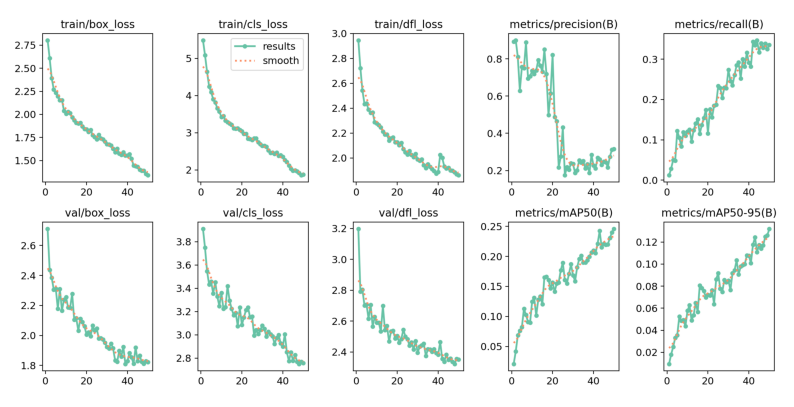

In [ ]:
import matplotlib.pyplot as plt
import cv2

# 이미지 경로 (YOLO가 저장한 결과는 runs 폴더 내부에 위치)
result_img_path = '/content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results9/results.png'  # 기본 저장 경로

# 이미지 읽기
img = cv2.imread(result_img_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# 시각화
plt.figure(figsize=(10, 10))
plt.imshow(img)
plt.axis('off')
plt.show()


#검증


In [ ]:
import pandas as pd


In [ ]:
# `/content/drive/MyDrive/bio/chest_project/duplicated_images_with_bbox_cleaned.csv` 을 불러오기
yolo_df = pd.read_csv('/content/drive/MyDrive/bio/chest_project/yolo_annotations.csv')
yolo_df.head()

,image_path,label,x_center,y_center,bbox_width,bbox_height,image_name
0,/content/drive/MyDrive/bio/chest_project/bbox_...,0,0.262182,0.572864,0.084746,0.077331,00013118_008.png
1,/content/drive/MyDrive/bio/chest_project/bbox_...,0,0.760593,0.281532,0.181144,0.306144,00014716_007.png
2,/content/drive/MyDrive/bio/chest_project/bbox_...,0,0.292373,0.415554,0.151483,0.211864,00029817_009.png
3,/content/drive/MyDrive/bio/chest_project/bbox_...,0,0.778072,0.510364,0.137712,0.054025,00014687_001.png
4,/content/drive/MyDrive/bio/chest_project/bbox_...,0,0.742585,0.594562,0.195975,0.076271,00017877_001.png


In [ ]:
# 'image_path' 별로 그룹화하고, 각 그룹 내에서 'label' 값의 개수를 셉니다.
# 그리고 'label' 개수가 1보다 큰 (즉, 라벨이 중복된) 그룹만 필터링합니다.
duplicated_labels_per_image = yolo_df.groupby('image_path')['label'].apply(lambda x: x.nunique() > 1)

# 라벨이 중복으로 있는 이미지 경로만 추출합니다.
images_with_duplicated_labels = duplicated_labels_per_image[duplicated_labels_per_image].index.tolist()

print(f"라벨이 중복으로 존재하는 이미지 수: {len(images_with_duplicated_labels)}")

if images_with_duplicated_labels:
    print("\n라벨이 중복으로 존재하는 이미지 경로 목록:")
    # 처음 몇 개의 중복 이미지 경로만 출력합니다.
    for img_path in images_with_duplicated_labels[:10]:
        print(img_path)

    print("\n첫 번째 중복 이미지의 상세 라벨 정보:")
    # 첫 번째 중복 이미지에 대한 yolo_df의 모든 행을 출력합니다.
    if len(images_with_duplicated_labels) > 0:
        first_duplicated_image_path = images_with_duplicated_labels[0]
        print(yolo_df[yolo_df['image_path'] == first_duplicated_image_path])

else:
    print("라벨이 중복으로 존재하는 이미지가 없습니다.")


라벨이 중복으로 존재하는 이미지 수: 93

라벨이 중복으로 존재하는 이미지 경로 목록:
/content/drive/MyDrive/bio/chest_project/bbox_list_img/00000732_005.png
/content/drive/MyDrive/bio/chest_project/bbox_list_img/00000830_000.png
/content/drive/MyDrive/bio/chest_project/bbox_list_img/00001836_082.png
/content/drive/MyDrive/bio/chest_project/bbox_list_img/00002106_000.png
/content/drive/MyDrive/bio/chest_project/bbox_list_img/00003440_000.png
/content/drive/MyDrive/bio/chest_project/bbox_list_img/00005066_030.png
/content/drive/MyDrive/bio/chest_project/bbox_list_img/00005089_014.png
/content/drive/MyDrive/bio/chest_project/bbox_list_img/00005869_001.png
/content/drive/MyDrive/bio/chest_project/bbox_list_img/00008814_010.png
/content/drive/MyDrive/bio/chest_project/bbox_list_img/00008841_025.png

첫 번째 중복 이미지의 상세 라벨 정보:
                                            image_path  label  x_center  \
202  /content/drive/MyDrive/bio/chest_project/bbox_...      2  0.619174   
918  /content/drive/MyDrive/bio/chest_project/bbox_...  

In [ ]:
import os

# 라벨 파일들이 저장된 경로
label_dir = '/content/drive/MyDrive/bio/chest_project/datasets/train/labels'

# 중복 라벨이 있는 파일 목록 저장
duplicated_label_files = []

# 디렉토리 내 모든 .txt 파일 검사
for filename in os.listdir(label_dir):
    if filename.endswith(".txt"):
        file_path = os.path.join(label_dir, filename)

        with open(file_path, 'r') as f:
            lines = f.readlines()
            if len(lines) > 1:  # 2줄 이상이면 중복 라벨 존재
                duplicated_label_files.append(filename)

# 결과 출력
print("📝 중복 라벨이 있는 이미지 수:", len(duplicated_label_files))
print("📄 중복 라벨 파일 목록:")
for fname in duplicated_label_files:
    print(f" - {fname}")


📝 중복 라벨이 있는 이미지 수: 92
📄 중복 라벨 파일 목록:
 - 00010575_002.txt
 - 00011857_001.txt
 - 00018253_017.txt
 - 00013508_001.txt
 - 00017582_003.txt
 - 00009437_008.txt
 - 00001836_082.txt
 - 00011827_003.txt
 - 00003440_000.txt
 - 00014447_004.txt
 - 00020393_003.txt
 - 00029502_006.txt
 - 00027556_007.txt
 - 00005089_014.txt
 - 00015300_000.txt
 - 00000830_000.txt
 - 00015440_000.txt
 - 00027697_001.txt
 - 00019018_007.txt
 - 00013670_151.txt
 - 00029808_003.txt
 - 00021009_001.txt
 - 00000732_005.txt
 - 00012261_001.txt
 - 00011402_007.txt
 - 00022215_012.txt
 - 00008814_010.txt
 - 00005066_030.txt
 - 00027479_013.txt
 - 00018253_059.txt
 - 00029579_005.txt
 - 00021703_001.txt
 - 00022369_013.txt
 - 00020482_032.txt
 - 00028383_002.txt
 - 00020000_000.txt
 - 00010277_000.txt
 - 00016837_002.txt
 - 00018366_029.txt
 - 00021840_016.txt
 - 00015090_006.txt
 - 00018387_030.txt
 - 00025252_053.txt
 - 00008841_025.txt
 - 00020274_007.txt
 - 00017138_037.txt
 - 00028640_008.txt
 - 00011237_094.txt
 - 

In [ ]:
import os

# 라벨 파일들이 저장된 경로
label_dir = '/content/drive/MyDrive/bio/chest_project/datasets/val/labels'

# 중복 라벨이 있는 파일 목록 저장
duplicated_label_files = []

# 디렉토리 내 모든 .txt 파일 검사
for filename in os.listdir(label_dir):
    if filename.endswith(".txt"):
        file_path = os.path.join(label_dir, filename)

        with open(file_path, 'r') as f:
            lines = f.readlines()
            if len(lines) > 1:  # 2줄 이상이면 중복 라벨 존재
                duplicated_label_files.append(filename)

# 결과 출력
print("📝 중복 라벨이 있는 이미지 수:", len(duplicated_label_files))
print("📄 중복 라벨 파일 목록:")
for fname in duplicated_label_files:
    print(f" - {fname}")


📝 중복 라벨이 있는 이미지 수: 32
📄 중복 라벨 파일 목록:
 - 00017500_002.txt
 - 00012834_008.txt
 - 00018427_004.txt
 - 00005066_030.txt
 - 00018387_030.txt
 - 00013249_033.txt
 - 00010828_039.txt
 - 00013993_077.txt
 - 00029464_015.txt
 - 00030408_013.txt
 - 00020405_041.txt
 - 00013993_083.txt
 - 00011269_019.txt
 - 00029502_006.txt
 - 00027479_013.txt
 - 00019018_007.txt
 - 00020482_032.txt
 - 00015069_001.txt
 - 00018253_054.txt
 - 00012505_007.txt
 - 00027357_014.txt
 - 00010277_000.txt
 - 00021201_010.txt
 - 00001836_082.txt
 - 00025529_018.txt
 - 00012021_081.txt
 - 00018393_000.txt
 - 00029431_000.txt
 - 00016705_006.txt
 - 00018366_029.txt
 - 00008841_025.txt
 - 00016837_002.txt


In [ ]:
from ultralytics import YOLO
import ultralytics
ultralytics.checks()

Ultralytics 8.3.156 🚀 Python-3.11.13 torch-2.6.0+cu124 CPU (Intel Xeon 2.20GHz)
Setup complete ✅ (8 CPUs, 51.0 GB RAM, 41.6/225.8 GB disk)


In [ ]:
import os
from ultralytics import YOLO
from tqdm import tqdm

# 라벨 파일들이 저장된 경로
label_dir = '/content/drive/MyDrive/bio/chest_project/datasets/val/labels'
image_dir = '/content/drive/MyDrive/bio/chest_project/datasets/val/images'

# 중복 라벨이 있는 파일 목록 수집
duplicated_label_files = []

for filename in os.listdir(label_dir):
    if filename.endswith(".txt"):
        file_path = os.path.join(label_dir, filename)
        with open(file_path, 'r') as f:
            lines = f.readlines()
            if len(lines) > 1:
                duplicated_label_files.append(filename)

# 모델 로드
model = YOLO('/content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results9/weights/best.pt')

# 예측 결과 확인
print(f"🧪 총 {len(duplicated_label_files)}개의 중복 라벨 이미지에 대해 예측을 수행합니다.\n")

for txt_file in tqdm(duplicated_label_files, desc="Predicting"):
    image_filename = txt_file.replace(".txt", ".png")
    image_path = os.path.join(image_dir, image_filename)

    if not os.path.exists(image_path):
        print(f"[⚠️ 누락] 이미지 파일이 존재하지 않음: {image_path}")
        continue

    results = model(image_path)
    r = results[0]
    boxes = r.boxes

    print(f"\n📌 Image: {image_filename}")
    print(f" - Number of detections: {len(boxes)}")

    if len(boxes) > 0:
        for box in boxes:
            class_id = int(box.cls)
            label = model.names[class_id]
            confidence = float(box.conf)
            bbox = box.xyxy[0].tolist()
            print(f"   → Label: {label}, Confidence: {confidence:.2f}, Bbox: {bbox}")
    else:
        print("   → ❌ No detections.")


🧪 총 32개의 중복 라벨 이미지에 대해 예측을 수행합니다.



Predicting:   0%|          | 0/32 [00:00<?, ?it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00017500_002.png: 1024x1024 (no detections), 525.9ms
Speed: 9.8ms preprocess, 525.9ms inference, 1.4ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:   3%|▎         | 1/32 [00:00<00:24,  1.24it/s]


📌 Image: 00017500_002.png
 - Number of detections: 0
   → ❌ No detections.

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00012834_008.png: 1024x1024 (no detections), 520.6ms
Speed: 4.9ms preprocess, 520.6ms inference, 1.1ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:   6%|▋         | 2/32 [00:01<00:27,  1.08it/s]


📌 Image: 00012834_008.png
 - Number of detections: 0
   → ❌ No detections.

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00018427_004.png: 1024x1024 2 Atelectasiss, 1 Nodule, 508.7ms
Speed: 5.0ms preprocess, 508.7ms inference, 19.5ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:   9%|▉         | 3/32 [00:02<00:28,  1.01it/s]


📌 Image: 00018427_004.png
 - Number of detections: 3
   → Label: Atelectasis, Confidence: 0.58, Bbox: [92.39764404296875, 622.075439453125, 265.241455078125, 713.7298583984375]
   → Label: Atelectasis, Confidence: 0.38, Bbox: [88.35551452636719, 630.3699951171875, 235.94740295410156, 706.8704833984375]
   → Label: Nodule, Confidence: 0.26, Bbox: [529.39111328125, 329.86517333984375, 633.430419921875, 430.35540771484375]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00005066_030.png: 1024x1024 1 Cardiomegaly, 1 Mass, 492.7ms
Speed: 4.9ms preprocess, 492.7ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  12%|█▎        | 4/32 [00:03<00:27,  1.04it/s]


📌 Image: 00005066_030.png
 - Number of detections: 2
   → Label: Cardiomegaly, Confidence: 0.58, Bbox: [266.4073486328125, 421.02911376953125, 792.9276123046875, 795.0370483398438]
   → Label: Mass, Confidence: 0.29, Bbox: [228.04986572265625, 530.14306640625, 318.47503662109375, 604.7216796875]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00018387_030.png: 1024x1024 (no detections), 493.5ms
Speed: 4.7ms preprocess, 493.5ms inference, 1.1ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  16%|█▌        | 5/32 [00:05<00:28,  1.06s/it]


📌 Image: 00018387_030.png
 - Number of detections: 0
   → ❌ No detections.

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00013249_033.png: 1024x1024 1 Cardiomegaly, 1 Pneumonia, 501.7ms
Speed: 4.9ms preprocess, 501.7ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  19%|█▉        | 6/32 [00:06<00:27,  1.07s/it]


📌 Image: 00013249_033.png
 - Number of detections: 2
   → Label: Cardiomegaly, Confidence: 0.82, Bbox: [416.05145263671875, 405.74847412109375, 873.6216430664062, 746.6178588867188]
   → Label: Pneumonia, Confidence: 0.29, Bbox: [359.80377197265625, 401.406005859375, 505.51373291015625, 688.940673828125]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00010828_039.png: 1024x1024 (no detections), 516.0ms
Speed: 5.5ms preprocess, 516.0ms inference, 1.0ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  22%|██▏       | 7/32 [00:07<00:28,  1.13s/it]


📌 Image: 00010828_039.png
 - Number of detections: 0
   → ❌ No detections.

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00013993_077.png: 1024x1024 (no detections), 501.1ms
Speed: 6.0ms preprocess, 501.1ms inference, 1.3ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  25%|██▌       | 8/32 [00:08<00:27,  1.16s/it]


📌 Image: 00013993_077.png
 - Number of detections: 0
   → ❌ No detections.

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00029464_015.png: 1024x1024 (no detections), 471.5ms
Speed: 4.7ms preprocess, 471.5ms inference, 1.0ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  28%|██▊       | 9/32 [00:09<00:26,  1.15s/it]


📌 Image: 00029464_015.png
 - Number of detections: 0
   → ❌ No detections.

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00030408_013.png: 1024x1024 (no detections), 498.1ms
Speed: 4.6ms preprocess, 498.1ms inference, 1.1ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  31%|███▏      | 10/32 [00:10<00:25,  1.15s/it]


📌 Image: 00030408_013.png
 - Number of detections: 0
   → ❌ No detections.

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00020405_041.png: 1024x1024 3 Effusions, 496.8ms
Speed: 4.8ms preprocess, 496.8ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  34%|███▍      | 11/32 [00:11<00:23,  1.13s/it]


📌 Image: 00020405_041.png
 - Number of detections: 3
   → Label: Effusion, Confidence: 0.33, Bbox: [96.32833099365234, 292.07208251953125, 278.9483337402344, 676.171875]
   → Label: Effusion, Confidence: 0.30, Bbox: [99.7916259765625, 207.15907287597656, 307.75653076171875, 677.0052490234375]
   → Label: Effusion, Confidence: 0.25, Bbox: [93.662109375, 402.58123779296875, 313.02581787109375, 685.5016479492188]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00013993_083.png: 1024x1024 1 Pneumonia, 501.6ms
Speed: 4.8ms preprocess, 501.6ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  38%|███▊      | 12/32 [00:12<00:21,  1.08s/it]


📌 Image: 00013993_083.png
 - Number of detections: 1
   → Label: Pneumonia, Confidence: 0.39, Bbox: [587.5458984375, 368.58770751953125, 830.2813720703125, 648.9329223632812]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00011269_019.png: 1024x1024 (no detections), 490.4ms
Speed: 6.6ms preprocess, 490.4ms inference, 1.0ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  41%|████      | 13/32 [00:14<00:22,  1.17s/it]


📌 Image: 00011269_019.png
 - Number of detections: 0
   → ❌ No detections.

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00029502_006.png: 1024x1024 (no detections), 539.2ms
Speed: 6.0ms preprocess, 539.2ms inference, 1.1ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  44%|████▍     | 14/32 [00:15<00:21,  1.17s/it]


📌 Image: 00029502_006.png
 - Number of detections: 0
   → ❌ No detections.

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00027479_013.png: 1024x1024 (no detections), 480.6ms
Speed: 4.7ms preprocess, 480.6ms inference, 1.1ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  47%|████▋     | 15/32 [00:16<00:18,  1.10s/it]


📌 Image: 00027479_013.png
 - Number of detections: 0
   → ❌ No detections.

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00019018_007.png: 1024x1024 1 Cardiomegaly, 487.4ms
Speed: 4.7ms preprocess, 487.4ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  50%|█████     | 16/32 [00:17<00:18,  1.19s/it]


📌 Image: 00019018_007.png
 - Number of detections: 1
   → Label: Cardiomegaly, Confidence: 0.74, Bbox: [357.07244873046875, 522.234130859375, 807.0734252929688, 811.71337890625]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00020482_032.png: 1024x1024 (no detections), 479.5ms
Speed: 4.9ms preprocess, 479.5ms inference, 1.1ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  53%|█████▎    | 17/32 [00:18<00:16,  1.10s/it]


📌 Image: 00020482_032.png
 - Number of detections: 0
   → ❌ No detections.

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00015069_001.png: 1024x1024 (no detections), 503.4ms
Speed: 4.9ms preprocess, 503.4ms inference, 1.1ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  56%|█████▋    | 18/32 [00:19<00:15,  1.11s/it]


📌 Image: 00015069_001.png
 - Number of detections: 0
   → ❌ No detections.

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00018253_054.png: 1024x1024 1 Effusion, 493.1ms
Speed: 4.8ms preprocess, 493.1ms inference, 1.4ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  59%|█████▉    | 19/32 [00:20<00:14,  1.12s/it]


📌 Image: 00018253_054.png
 - Number of detections: 1
   → Label: Effusion, Confidence: 0.28, Bbox: [183.57757568359375, 200.85882568359375, 437.69293212890625, 805.533447265625]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00012505_007.png: 1024x1024 2 Atelectasiss, 498.8ms
Speed: 4.9ms preprocess, 498.8ms inference, 2.0ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  62%|██████▎   | 20/32 [00:22<00:13,  1.12s/it]


📌 Image: 00012505_007.png
 - Number of detections: 2
   → Label: Atelectasis, Confidence: 0.55, Bbox: [327.16864013671875, 453.71942138671875, 441.9737548828125, 513.1776733398438]
   → Label: Atelectasis, Confidence: 0.34, Bbox: [313.53436279296875, 440.3621826171875, 445.4630126953125, 518.9894409179688]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00027357_014.png: 1024x1024 (no detections), 503.0ms
Speed: 4.8ms preprocess, 503.0ms inference, 1.1ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  66%|██████▌   | 21/32 [00:23<00:12,  1.14s/it]


📌 Image: 00027357_014.png
 - Number of detections: 0
   → ❌ No detections.

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00010277_000.png: 1024x1024 (no detections), 502.2ms
Speed: 5.4ms preprocess, 502.2ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  69%|██████▉   | 22/32 [00:24<00:11,  1.14s/it]


📌 Image: 00010277_000.png
 - Number of detections: 0
   → ❌ No detections.

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00021201_010.png: 1024x1024 1 Pneumonia, 509.0ms
Speed: 6.5ms preprocess, 509.0ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  72%|███████▏  | 23/32 [00:25<00:10,  1.13s/it]


📌 Image: 00021201_010.png
 - Number of detections: 1
   → Label: Pneumonia, Confidence: 0.38, Bbox: [683.9161376953125, 134.5998992919922, 893.907470703125, 567.2963256835938]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00001836_082.png: 1024x1024 2 Atelectasiss, 1 Mass, 517.7ms
Speed: 16.3ms preprocess, 517.7ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  75%|███████▌  | 24/32 [00:26<00:08,  1.12s/it]


📌 Image: 00001836_082.png
 - Number of detections: 3
   → Label: Atelectasis, Confidence: 0.57, Bbox: [161.00637817382812, 574.4315185546875, 342.8970031738281, 679.35791015625]
   → Label: Mass, Confidence: 0.51, Bbox: [344.8848876953125, 380.1973876953125, 476.020751953125, 508.24609375]
   → Label: Atelectasis, Confidence: 0.36, Bbox: [155.328125, 578.52392578125, 314.4668273925781, 665.24072265625]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00025529_018.png: 1024x1024 1 Effusion, 1 Mass, 552.9ms
Speed: 6.7ms preprocess, 552.9ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  78%|███████▊  | 25/32 [00:27<00:08,  1.18s/it]


📌 Image: 00025529_018.png
 - Number of detections: 2
   → Label: Mass, Confidence: 0.62, Bbox: [711.2537841796875, 396.51910400390625, 817.6480712890625, 512.626953125]
   → Label: Effusion, Confidence: 0.26, Bbox: [688.5834350585938, 165.9417724609375, 901.8551635742188, 673.785888671875]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00012021_081.png: 1024x1024 1 Pneumonia, 495.8ms
Speed: 4.8ms preprocess, 495.8ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  81%|████████▏ | 26/32 [00:28<00:06,  1.12s/it]


📌 Image: 00012021_081.png
 - Number of detections: 1
   → Label: Pneumonia, Confidence: 0.28, Bbox: [664.300048828125, 208.0064239501953, 853.255859375, 589.1776733398438]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00018393_000.png: 1024x1024 (no detections), 505.4ms
Speed: 6.1ms preprocess, 505.4ms inference, 1.2ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  84%|████████▍ | 27/32 [00:30<00:05,  1.13s/it]


📌 Image: 00018393_000.png
 - Number of detections: 0
   → ❌ No detections.

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00029431_000.png: 1024x1024 (no detections), 501.8ms
Speed: 4.8ms preprocess, 501.8ms inference, 1.1ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  88%|████████▊ | 28/32 [00:31<00:04,  1.08s/it]


📌 Image: 00029431_000.png
 - Number of detections: 0
   → ❌ No detections.

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00016705_006.png: 1024x1024 (no detections), 495.4ms
Speed: 4.8ms preprocess, 495.4ms inference, 1.2ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  91%|█████████ | 29/32 [00:32<00:03,  1.06s/it]


📌 Image: 00016705_006.png
 - Number of detections: 0
   → ❌ No detections.

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00018366_029.png: 1024x1024 (no detections), 485.8ms
Speed: 4.7ms preprocess, 485.8ms inference, 1.1ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  94%|█████████▍| 30/32 [00:33<00:02,  1.14s/it]


📌 Image: 00018366_029.png
 - Number of detections: 0
   → ❌ No detections.

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00008841_025.png: 1024x1024 (no detections), 499.4ms
Speed: 4.8ms preprocess, 499.4ms inference, 1.2ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  97%|█████████▋| 31/32 [00:34<00:01,  1.12s/it]


📌 Image: 00008841_025.png
 - Number of detections: 0
   → ❌ No detections.

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00016837_002.png: 1024x1024 1 Atelectasis, 514.0ms
Speed: 4.9ms preprocess, 514.0ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting: 100%|██████████| 32/32 [00:35<00:00,  1.11s/it]


📌 Image: 00016837_002.png
 - Number of detections: 1
   → Label: Atelectasis, Confidence: 0.28, Bbox: [140.76329040527344, 649.019287109375, 394.025146484375, 751.55859375]


In [ ]:
import os
from ultralytics import YOLO
from tqdm import tqdm

# 경로 설정
label_dir = '/content/drive/MyDrive/bio/chest_project/datasets/val/labels'
image_dir = '/content/drive/MyDrive/bio/chest_project/datasets/val/images'
output_path = '/content/drive/MyDrive/bio/chest_project/detected_images.txt'

# 중복 라벨이 있는 파일 목록 수집
duplicated_label_files = []
for filename in os.listdir(label_dir):
    if filename.endswith(".txt"):
        file_path = os.path.join(label_dir, filename)
        with open(file_path, 'r') as f:
            if sum(1 for _ in f) > 1:
                duplicated_label_files.append(filename)

# 모델 로드
model = YOLO('/content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results16/weights/best.pt')

# 검출된 이미지 파일 저장용 리스트
successful_detections = []

print(f"🧪 총 {len(duplicated_label_files)}개의 중복 라벨 이미지에 대해 예측을 수행합니다.\n")

for txt_file in tqdm(duplicated_label_files, desc="Predicting"):
    image_filename = txt_file.replace(".txt", ".png")
    image_path = os.path.join(image_dir, image_filename)

    if not os.path.exists(image_path):
        print(f"[⚠️ 누락] 이미지 파일이 존재하지 않음: {image_path}")
        continue

    results = model(image_path)
    r = results[0]
    boxes = r.boxes

    print(f"\n📌 Image: {image_filename}")
    print(f" - Number of detections: {len(boxes)}")

    if len(boxes) > 0:
        successful_detections.append(image_filename)
        for box in boxes:
            class_id = int(box.cls)
            label = model.names[class_id]
            confidence = float(box.conf)
            bbox = box.xyxy[0].tolist()
            print(f"   → Label: {label}, Confidence: {confidence:.2f}, Bbox: {bbox}")
    else:
        print("   → ❌ No detections.")

# 결과 저장
with open(output_path, 'w') as f:
    for img in successful_detections:
        f.write(img + '\n')

print(f"\n✅ 검출된 이미지 {len(successful_detections)}개를 '{output_path}'에 저장 완료.")


🧪 총 32개의 중복 라벨 이미지에 대해 예측을 수행합니다.



Predicting:   0%|          | 0/32 [00:00<?, ?it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00017500_002.png: 1024x1024 1 Atelectasis, 1 Effusion, 32.7ms
Speed: 4.2ms preprocess, 32.7ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:   3%|▎         | 1/32 [00:00<00:08,  3.74it/s]


📌 Image: 00017500_002.png
 - Number of detections: 2
   → Label: Effusion, Confidence: 0.91, Bbox: [114.38134002685547, 493.734130859375, 312.3212890625, 769.74560546875]
   → Label: Atelectasis, Confidence: 0.89, Bbox: [762.7139892578125, 613.2412719726562, 873.0821533203125, 676.6716918945312]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00012834_008.png: 1024x1024 1 Atelectasis, 1 Effusion, 32.4ms
Speed: 4.3ms preprocess, 32.4ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00012834_008.png
 - Number of detections: 2
   → Label: Effusion, Confidence: 0.98, Bbox: [4.604156494140625, 352.63818359375, 273.6772155761719, 784.8790283203125]
   → Label: Atelectasis, Confidence: 0.85, Bbox: [112.6632080078125, 412.80511474609375, 309.81622314453125, 484.85675048828125]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00018427_004.png: 1024x1024 1 Atelectasis, 1 Effusion, 1 Mass, 32.1ms
Speed: 5.2ms preprocess

Predicting:   9%|▉         | 3/32 [00:00<00:03,  8.36it/s]


📌 Image: 00018427_004.png
 - Number of detections: 3
   → Label: Mass, Confidence: 0.92, Bbox: [531.0335083007812, 328.8663635253906, 639.1505737304688, 429.5040588378906]
   → Label: Effusion, Confidence: 0.89, Bbox: [766.134765625, 340.6353759765625, 955.5228271484375, 882.809326171875]
   → Label: Atelectasis, Confidence: 0.86, Bbox: [94.94418334960938, 632.1844482421875, 273.8984680175781, 703.7099609375]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00005066_030.png: 1024x1024 1 Effusion, 1 Cardiomegaly, 1 Infiltrate, 32.1ms
Speed: 4.8ms preprocess, 32.1ms inference, 2.0ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00005066_030.png
 - Number of detections: 3
   → Label: Cardiomegaly, Confidence: 0.94, Bbox: [275.6558837890625, 460.2489013671875, 808.1995849609375, 761.9208984375]
   → Label: Infiltrate, Confidence: 0.92, Bbox: [529.5820922851562, 501.20892333984375, 774.0712280273438, 662.9866333007812]
   → Label: Effusion, Confidence: 

Predicting:  16%|█▌        | 5/32 [00:00<00:02, 10.70it/s]


📌 Image: 00018387_030.png
 - Number of detections: 4
   → Label: Cardiomegaly, Confidence: 0.78, Bbox: [386.8220520019531, 357.239501953125, 866.853271484375, 647.4083251953125]
   → Label: Effusion, Confidence: 0.77, Bbox: [166.6005859375, 444.236328125, 835.9599609375, 595.6337890625]
   → Label: Effusion, Confidence: 0.51, Bbox: [535.6025390625, 453.0201416015625, 936.4755859375, 599.201904296875]
   → Label: Effusion, Confidence: 0.27, Bbox: [350.6034240722656, 452.0140380859375, 935.8363037109375, 594.3919677734375]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00013249_033.png: 1024x1024 1 Cardiomegaly, 1 Pneumonia, 28.8ms
Speed: 4.9ms preprocess, 28.8ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00013249_033.png
 - Number of detections: 2
   → Label: Cardiomegaly, Confidence: 0.94, Bbox: [417.75927734375, 402.6963806152344, 887.9617919921875, 745.7540283203125]
   → Label: Pneumonia, Confidence: 0.83, Bbox: [359.522003

Predicting:  22%|██▏       | 7/32 [00:00<00:02, 12.26it/s]

   → Label: Effusion, Confidence: 0.33, Bbox: [698.7032470703125, 446.4991455078125, 943.6285400390625, 692.2916259765625]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00013993_077.png: 1024x1024 1 Effusion, 1 Pneumonia, 27.1ms
Speed: 4.2ms preprocess, 27.1ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00013993_077.png
 - Number of detections: 2
   → Label: Effusion, Confidence: 0.99, Bbox: [163.3268585205078, 408.32879638671875, 373.03411865234375, 631.1146850585938]
   → Label: Pneumonia, Confidence: 0.94, Bbox: [191.66046142578125, 399.9776916503906, 783.671142578125, 798.2259521484375]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00029464_015.png: 1024x1024 1 Atelectasis, 1 Effusion, 24.9ms
Speed: 4.1ms preprocess, 24.9ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  28%|██▊       | 9/32 [00:00<00:01, 13.62it/s]


📌 Image: 00029464_015.png
 - Number of detections: 2
   → Label: Effusion, Confidence: 0.87, Bbox: [717.9439697265625, 610.4747924804688, 909.5697021484375, 661.7166137695312]
   → Label: Atelectasis, Confidence: 0.80, Bbox: [189.46429443359375, 349.93646240234375, 815.7051391601562, 665.178955078125]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00030408_013.png: 1024x1024 1 Effusion, 1 Infiltrate, 24.8ms
Speed: 5.2ms preprocess, 24.8ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00030408_013.png
 - Number of detections: 2
   → Label: Infiltrate, Confidence: 0.97, Bbox: [139.72433471679688, 721.524169921875, 366.99761962890625, 872.790283203125]
   → Label: Effusion, Confidence: 0.91, Bbox: [718.1228637695312, 600.102783203125, 837.0453491210938, 749.907958984375]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00020405_041.png: 1024x1024 1 Effusion, 1 Infiltrate, 24.8ms
Speed: 4.2ms preprocess, 24.8ms

Predicting:  34%|███▍      | 11/32 [00:00<00:01, 14.79it/s]


📌 Image: 00020405_041.png
 - Number of detections: 2
   → Label: Effusion, Confidence: 0.96, Bbox: [109.48074340820312, 279.1578369140625, 313.6070556640625, 667.2022094726562]
   → Label: Infiltrate, Confidence: 0.94, Bbox: [590.66455078125, 403.7648620605469, 851.55322265625, 784.94775390625]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00013993_083.png: 1024x1024 1 Pneumonia, 22.8ms
Speed: 4.1ms preprocess, 22.8ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00013993_083.png
 - Number of detections: 1
   → Label: Pneumonia, Confidence: 0.27, Bbox: [579.763427734375, 369.2193908691406, 855.317626953125, 708.3001708984375]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00011269_019.png: 1024x1024 1 Effusion, 1 Mass, 22.8ms
Speed: 4.1ms preprocess, 22.8ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  41%|████      | 13/32 [00:01<00:01, 15.43it/s]


📌 Image: 00011269_019.png
 - Number of detections: 2
   → Label: Effusion, Confidence: 0.97, Bbox: [733.537109375, 418.7901306152344, 946.576904296875, 614.7691650390625]
   → Label: Mass, Confidence: 0.95, Bbox: [572.7659912109375, 265.9578857421875, 699.9937744140625, 414.9072265625]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00029502_006.png: 1024x1024 1 Atelectasis, 1 Effusion, 22.6ms
Speed: 4.0ms preprocess, 22.6ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00029502_006.png
 - Number of detections: 2
   → Label: Effusion, Confidence: 0.92, Bbox: [151.52566528320312, 469.8345947265625, 409.0453796386719, 846.789306640625]
   → Label: Atelectasis, Confidence: 0.91, Bbox: [226.981689453125, 592.865234375, 468.1492919921875, 766.702880859375]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00027479_013.png: 1024x1024 1 Effusion, 1 Infiltrate, 22.5ms
Speed: 4.1ms preprocess, 22.5ms inference, 1.7ms 

Predicting:  47%|████▋     | 15/32 [00:01<00:01, 16.59it/s]


📌 Image: 00027479_013.png
 - Number of detections: 2
   → Label: Infiltrate, Confidence: 0.96, Bbox: [217.21484375, 106.179443359375, 921.470947265625, 586.0482177734375]
   → Label: Effusion, Confidence: 0.79, Bbox: [767.9977416992188, 565.5206909179688, 955.7144165039062, 642.9494018554688]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00019018_007.png: 1024x1024 1 Cardiomegaly, 1 Infiltrate, 22.0ms
Speed: 4.2ms preprocess, 22.0ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00019018_007.png
 - Number of detections: 2
   → Label: Infiltrate, Confidence: 0.98, Bbox: [188.603271484375, 298.4405212402344, 779.357666015625, 757.6942138671875]
   → Label: Cardiomegaly, Confidence: 0.96, Bbox: [365.7257995605469, 524.457763671875, 812.679443359375, 786.694580078125]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00020482_032.png: 1024x1024 1 Atelectasis, 1 Effusion, 1 Infiltrate, 22.0ms
Speed: 4.1ms preproc

Predicting:  53%|█████▎    | 17/32 [00:01<00:00, 17.37it/s]


📌 Image: 00020482_032.png
 - Number of detections: 3
   → Label: Infiltrate, Confidence: 0.94, Bbox: [471.7424621582031, 419.243408203125, 694.780029296875, 675.09130859375]
   → Label: Effusion, Confidence: 0.84, Bbox: [434.5576171875, 416.9517517089844, 705.4854736328125, 680.2769775390625]
   → Label: Atelectasis, Confidence: 0.52, Bbox: [472.0749816894531, 408.4753723144531, 695.696533203125, 697.03759765625]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00015069_001.png: 1024x1024 1 Infiltrate, 1 Pneumonia, 21.7ms
Speed: 4.2ms preprocess, 21.7ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00015069_001.png
 - Number of detections: 2
   → Label: Infiltrate, Confidence: 0.96, Bbox: [181.708740234375, 190.60382080078125, 841.552490234375, 717.1273803710938]
   → Label: Pneumonia, Confidence: 0.48, Bbox: [182.418212890625, 253.14923095703125, 834.1937255859375, 714.6180419921875]

image 1/1 /content/drive/MyDrive/bio/chest_pro

Predicting:  59%|█████▉    | 19/32 [00:01<00:00, 17.36it/s]


📌 Image: 00018253_054.png
 - Number of detections: 2
   → Label: Effusion, Confidence: 0.96, Bbox: [181.44146728515625, 294.1954345703125, 423.73724365234375, 825.46484375]
   → Label: Infiltrate, Confidence: 0.91, Bbox: [264.48394775390625, 463.557373046875, 460.16168212890625, 655.1732177734375]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00012505_007.png: 1024x1024 1 Effusion, 1 Infiltrate, 21.7ms
Speed: 4.0ms preprocess, 21.7ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00012505_007.png
 - Number of detections: 2
   → Label: Infiltrate, Confidence: 0.94, Bbox: [340.417724609375, 405.9596252441406, 534.6058349609375, 634.2357177734375]
   → Label: Effusion, Confidence: 0.93, Bbox: [248.68450927734375, 166.0743408203125, 495.3507080078125, 705.4134521484375]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00027357_014.png: 1024x1024 1 Effusion, 1 Infiltrate, 21.7ms
Speed: 4.2ms preprocess, 21.7ms i

Predicting:  66%|██████▌   | 21/32 [00:01<00:00, 17.87it/s]


📌 Image: 00027357_014.png
 - Number of detections: 2
   → Label: Infiltrate, Confidence: 0.96, Bbox: [655.1395263671875, 457.05718994140625, 785.0740966796875, 650.1370239257812]
   → Label: Effusion, Confidence: 0.87, Bbox: [62.46478271484375, 107.16949462890625, 334.7626953125, 742.2722778320312]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00010277_000.png: 1024x1024 1 Effusion, 1 Infiltrate, 1 Pneumonia, 1 Mass, 21.7ms
Speed: 5.9ms preprocess, 21.7ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00010277_000.png
 - Number of detections: 4
   → Label: Effusion, Confidence: 0.97, Bbox: [860.9677734375, 690.0794677734375, 939.036865234375, 811.9591064453125]
   → Label: Mass, Confidence: 0.95, Bbox: [300.5818786621094, 309.9573974609375, 831.3546142578125, 590.1255493164062]
   → Label: Pneumonia, Confidence: 0.91, Bbox: [639.07763671875, 418.034423828125, 901.59375, 643.48974609375]
   → Label: Infiltrate, Confidence: 0.34, B

Predicting:  72%|███████▏  | 23/32 [00:01<00:00, 17.69it/s]


📌 Image: 00021201_010.png
 - Number of detections: 2
   → Label: Mass, Confidence: 0.95, Bbox: [713.7567138671875, 193.981201171875, 870.5003662109375, 514.2203369140625]
   → Label: Infiltrate, Confidence: 0.92, Bbox: [693.0787353515625, 137.54425048828125, 883.8409423828125, 584.6146240234375]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00001836_082.png: 1024x1024 1 Atelectasis, 1 Mass, 20.2ms
Speed: 4.2ms preprocess, 20.2ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00001836_082.png
 - Number of detections: 2
   → Label: Atelectasis, Confidence: 0.95, Bbox: [168.31369018554688, 568.355224609375, 330.0936279296875, 681.9072265625]
   → Label: Mass, Confidence: 0.92, Bbox: [338.47760009765625, 389.1148681640625, 476.18707275390625, 504.4886474609375]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00025529_018.png: 1024x1024 1 Effusion, 1 Mass, 20.0ms
Speed: 4.1ms preprocess, 20.0ms inference, 1.5ms

Predicting:  78%|███████▊  | 25/32 [00:01<00:00, 18.32it/s]


📌 Image: 00025529_018.png
 - Number of detections: 2
   → Label: Mass, Confidence: 0.97, Bbox: [705.126220703125, 390.9259033203125, 811.7144775390625, 517.918212890625]
   → Label: Effusion, Confidence: 0.79, Bbox: [723.596923828125, 174.729248046875, 907.52001953125, 749.5843505859375]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00012021_081.png: 1024x1024 1 Infiltrate, 1 Pneumonia, 20.0ms
Speed: 4.3ms preprocess, 20.0ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00012021_081.png
 - Number of detections: 2
   → Label: Pneumonia, Confidence: 0.97, Bbox: [660.3917236328125, 187.02239990234375, 858.3919677734375, 645.9840698242188]
   → Label: Infiltrate, Confidence: 0.92, Bbox: [658.293212890625, 443.9886169433594, 846.344482421875, 641.7823486328125]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00018393_000.png: 1024x1024 1 Infiltrate, 1 Pneumonia, 19.9ms
Speed: 4.1ms preprocess, 19.9ms inference

Predicting:  88%|████████▊ | 28/32 [00:01<00:00, 18.89it/s]



image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00016705_006.png: 1024x1024 1 Infiltrate, 1 Pneumonia, 19.9ms
Speed: 4.3ms preprocess, 19.9ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00016705_006.png
 - Number of detections: 2
   → Label: Infiltrate, Confidence: 0.88, Bbox: [692.7913818359375, 311.18359375, 789.5037841796875, 553.50146484375]
   → Label: Pneumonia, Confidence: 0.64, Bbox: [696.5806884765625, 328.4892578125, 787.5548095703125, 550.650390625]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00018366_029.png: 1024x1024 1 Effusion, 1 Pneumothorax, 19.7ms
Speed: 4.0ms preprocess, 19.7ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00018366_029.png
 - Number of detections: 2
   → Label: Pneumothorax, Confidence: 0.97, Bbox: [592.408935546875, 130.5870361328125, 794.173828125, 322.04931640625]
   → Label: Effusion, Confidence: 0.92, Bbox: [555.765380859375, 471.

Predicting:  97%|█████████▋| 31/32 [00:01<00:00, 18.92it/s]


📌 Image: 00008841_025.png
 - Number of detections: 2
   → Label: Pneumothorax, Confidence: 0.92, Bbox: [586.4285888671875, 80.06744384765625, 783.1221923828125, 169.08560180664062]
   → Label: Effusion, Confidence: 0.90, Bbox: [154.36093139648438, 486.819580078125, 420.5301818847656, 589.623779296875]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00016837_002.png: 1024x1024 1 Atelectasis, 1 Effusion, 19.7ms
Speed: 3.8ms preprocess, 19.7ms inference, 1.4ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting: 100%|██████████| 32/32 [00:02<00:00, 15.84it/s]


📌 Image: 00016837_002.png
 - Number of detections: 2
   → Label: Atelectasis, Confidence: 0.94, Bbox: [144.6524658203125, 657.3034057617188, 394.9732666015625, 753.1237182617188]
   → Label: Effusion, Confidence: 0.90, Bbox: [144.9031219482422, 707.4690551757812, 393.49468994140625, 770.7266235351562]

✅ 검출된 이미지 32개를 '/content/drive/MyDrive/bio/chest_project/detected_images.txt'에 저장 완료.


In [ ]:
import os
from ultralytics import YOLO
from tqdm import tqdm

# 경로 설정
label_dir = '/content/drive/MyDrive/bio/chest_project/datasets/val/labels'
image_dir = '/content/drive/MyDrive/bio/chest_project/datasets/val/images'
output_path = '/content/drive/MyDrive/bio/chest_project/detected_images.txt'

# 중복 라벨이 있는 파일 목록 수집
duplicated_label_files = []
for filename in os.listdir(label_dir):
    if filename.endswith(".txt"):
        file_path = os.path.join(label_dir, filename)
        with open(file_path, 'r') as f:
            if sum(1 for _ in f) > 1:
                duplicated_label_files.append(filename)

# 모델 로드
model = YOLO('/content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results16/weights/best.pt')

# 검출된 이미지 파일 저장용 리스트
successful_detections = []

print(f"🧪 총 {len(duplicated_label_files)}개의 중복 라벨 이미지에 대해 예측을 수행합니다.\n")

for txt_file in tqdm(duplicated_label_files, desc="Predicting"):
    image_filename = txt_file.replace(".txt", ".png")
    image_path = os.path.join(image_dir, image_filename)

    if not os.path.exists(image_path):
        print(f"[⚠️ 누락] 이미지 파일이 존재하지 않음: {image_path}")
        continue

    results = model(image_path)
    r = results[0]
    boxes = r.boxes

    print(f"\n📌 Image: {image_filename}")
    print(f" - Number of detections: {len(boxes)}")

    if len(boxes) > 0:
        successful_detections.append(image_filename)
        for box in boxes:
            class_id = int(box.cls)
            label = model.names[class_id]
            confidence = float(box.conf)
            bbox = box.xyxy[0].tolist()
            print(f"   → Label: {label}, Confidence: {confidence:.2f}, Bbox: {bbox}")
    else:
        print("   → ❌ No detections.")

# 결과 저장
with open(output_path, 'w') as f:
    for img in successful_detections:
        f.write(img + '\n')

print(f"\n✅ 검출된 이미지 {len(successful_detections)}개를 '{output_path}'에 저장 완료.")


🧪 총 32개의 중복 라벨 이미지에 대해 예측을 수행합니다.



Predicting:   0%|          | 0/32 [00:00<?, ?it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00017500_002.png: 1024x1024 1 Atelectasis, 1 Effusion, 32.7ms
Speed: 4.2ms preprocess, 32.7ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:   3%|▎         | 1/32 [00:00<00:07,  4.00it/s]


📌 Image: 00017500_002.png
 - Number of detections: 2
   → Label: Effusion, Confidence: 0.91, Bbox: [114.38134002685547, 493.734130859375, 312.3212890625, 769.74560546875]
   → Label: Atelectasis, Confidence: 0.89, Bbox: [762.7139892578125, 613.2412719726562, 873.0821533203125, 676.6716918945312]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00012834_008.png: 1024x1024 1 Atelectasis, 1 Effusion, 32.7ms
Speed: 3.9ms preprocess, 32.7ms inference, 1.4ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00012834_008.png
 - Number of detections: 2
   → Label: Effusion, Confidence: 0.98, Bbox: [4.604156494140625, 352.63818359375, 273.6772155761719, 784.8790283203125]
   → Label: Atelectasis, Confidence: 0.85, Bbox: [112.6632080078125, 412.80511474609375, 309.81622314453125, 484.85675048828125]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00018427_004.png: 1024x1024 1 Atelectasis, 1 Effusion, 1 Mass, 32.7ms
Speed: 3.9ms preprocess

Predicting:   9%|▉         | 3/32 [00:00<00:03,  9.04it/s]


📌 Image: 00018427_004.png
 - Number of detections: 3
   → Label: Mass, Confidence: 0.92, Bbox: [531.0335083007812, 328.8663635253906, 639.1505737304688, 429.5040588378906]
   → Label: Effusion, Confidence: 0.89, Bbox: [766.134765625, 340.6353759765625, 955.5228271484375, 882.809326171875]
   → Label: Atelectasis, Confidence: 0.86, Bbox: [94.94418334960938, 632.1844482421875, 273.8984680175781, 703.7099609375]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00005066_030.png: 1024x1024 1 Effusion, 1 Cardiomegaly, 1 Infiltrate, 26.2ms
Speed: 3.8ms preprocess, 26.2ms inference, 1.4ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00005066_030.png
 - Number of detections: 3
   → Label: Cardiomegaly, Confidence: 0.94, Bbox: [275.6558837890625, 460.2489013671875, 808.1995849609375, 761.9208984375]
   → Label: Infiltrate, Confidence: 0.92, Bbox: [529.5820922851562, 501.20892333984375, 774.0712280273438, 662.9866333007812]
   → Label: Effusion, Confidence: 

Predicting:  16%|█▌        | 5/32 [00:00<00:02, 12.29it/s]


📌 Image: 00018387_030.png
 - Number of detections: 4
   → Label: Cardiomegaly, Confidence: 0.78, Bbox: [386.8220520019531, 357.239501953125, 866.853271484375, 647.4083251953125]
   → Label: Effusion, Confidence: 0.77, Bbox: [166.6005859375, 444.236328125, 835.9599609375, 595.6337890625]
   → Label: Effusion, Confidence: 0.51, Bbox: [535.6025390625, 453.0201416015625, 936.4755859375, 599.201904296875]
   → Label: Effusion, Confidence: 0.27, Bbox: [350.6034240722656, 452.0140380859375, 935.8363037109375, 594.3919677734375]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00013249_033.png: 1024x1024 1 Cardiomegaly, 1 Pneumonia, 26.2ms
Speed: 4.0ms preprocess, 26.2ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00013249_033.png
 - Number of detections: 2
   → Label: Cardiomegaly, Confidence: 0.94, Bbox: [417.75927734375, 402.6963806152344, 887.9617919921875, 745.7540283203125]
   → Label: Pneumonia, Confidence: 0.83, Bbox: [359.522003

Predicting:  22%|██▏       | 7/32 [00:00<00:01, 13.94it/s]


📌 Image: 00010828_039.png
 - Number of detections: 3
   → Label: Atelectasis, Confidence: 0.88, Bbox: [587.1431274414062, 470.8460693359375, 801.4788208007812, 694.7347412109375]
   → Label: Infiltrate, Confidence: 0.87, Bbox: [671.5555419921875, 447.42572021484375, 918.7877197265625, 697.1187133789062]
   → Label: Effusion, Confidence: 0.33, Bbox: [698.7032470703125, 446.4991455078125, 943.6285400390625, 692.2916259765625]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00013993_077.png: 1024x1024 1 Effusion, 1 Pneumonia, 22.0ms
Speed: 3.8ms preprocess, 22.0ms inference, 1.4ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00013993_077.png
 - Number of detections: 2
   → Label: Effusion, Confidence: 0.99, Bbox: [163.3268585205078, 408.32879638671875, 373.03411865234375, 631.1146850585938]
   → Label: Pneumonia, Confidence: 0.94, Bbox: [191.66046142578125, 399.9776916503906, 783.671142578125, 798.2259521484375]

image 1/1 /content/drive/MyDrive/bio

Predicting:  31%|███▏      | 10/32 [00:00<00:01, 16.42it/s]


📌 Image: 00030408_013.png
 - Number of detections: 2
   → Label: Infiltrate, Confidence: 0.97, Bbox: [139.72433471679688, 721.524169921875, 366.99761962890625, 872.790283203125]
   → Label: Effusion, Confidence: 0.91, Bbox: [718.1228637695312, 600.102783203125, 837.0453491210938, 749.907958984375]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00020405_041.png: 1024x1024 1 Effusion, 1 Infiltrate, 21.8ms
Speed: 4.1ms preprocess, 21.8ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00020405_041.png
 - Number of detections: 2
   → Label: Effusion, Confidence: 0.96, Bbox: [109.48074340820312, 279.1578369140625, 313.6070556640625, 667.2022094726562]
   → Label: Infiltrate, Confidence: 0.94, Bbox: [590.66455078125, 403.7648620605469, 851.55322265625, 784.94775390625]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00013993_083.png: 1024x1024 1 Pneumonia, 20.0ms
Speed: 4.1ms preprocess, 20.0ms inference, 1.6ms po

Predicting:  38%|███▊      | 12/32 [00:00<00:01, 16.79it/s]


📌 Image: 00013993_083.png
 - Number of detections: 1
   → Label: Pneumonia, Confidence: 0.27, Bbox: [579.763427734375, 369.2193908691406, 855.317626953125, 708.3001708984375]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00011269_019.png: 1024x1024 1 Effusion, 1 Mass, 19.9ms
Speed: 4.5ms preprocess, 19.9ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00011269_019.png
 - Number of detections: 2
   → Label: Effusion, Confidence: 0.97, Bbox: [733.537109375, 418.7901306152344, 946.576904296875, 614.7691650390625]
   → Label: Mass, Confidence: 0.95, Bbox: [572.7659912109375, 265.9578857421875, 699.9937744140625, 414.9072265625]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00029502_006.png: 1024x1024 1 Atelectasis, 1 Effusion, 19.8ms
Speed: 4.6ms preprocess, 19.8ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  44%|████▍     | 14/32 [00:00<00:01, 16.72it/s]


📌 Image: 00029502_006.png
 - Number of detections: 2
   → Label: Effusion, Confidence: 0.92, Bbox: [151.52566528320312, 469.8345947265625, 409.0453796386719, 846.789306640625]
   → Label: Atelectasis, Confidence: 0.91, Bbox: [226.981689453125, 592.865234375, 468.1492919921875, 766.702880859375]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00027479_013.png: 1024x1024 1 Effusion, 1 Infiltrate, 19.8ms
Speed: 5.9ms preprocess, 19.8ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00027479_013.png
 - Number of detections: 2
   → Label: Infiltrate, Confidence: 0.96, Bbox: [217.21484375, 106.179443359375, 921.470947265625, 586.0482177734375]
   → Label: Effusion, Confidence: 0.79, Bbox: [767.9977416992188, 565.5206909179688, 955.7144165039062, 642.9494018554688]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00019018_007.png: 1024x1024 1 Cardiomegaly, 1 Infiltrate, 19.7ms
Speed: 3.8ms preprocess, 19.7ms inferen

Predicting:  50%|█████     | 16/32 [00:01<00:00, 17.53it/s]


📌 Image: 00019018_007.png
 - Number of detections: 2
   → Label: Infiltrate, Confidence: 0.98, Bbox: [188.603271484375, 298.4405212402344, 779.357666015625, 757.6942138671875]
   → Label: Cardiomegaly, Confidence: 0.96, Bbox: [365.7257995605469, 524.457763671875, 812.679443359375, 786.694580078125]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00020482_032.png: 1024x1024 1 Atelectasis, 1 Effusion, 1 Infiltrate, 19.8ms
Speed: 5.7ms preprocess, 19.8ms inference, 1.4ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00020482_032.png
 - Number of detections: 3
   → Label: Infiltrate, Confidence: 0.94, Bbox: [471.7424621582031, 419.243408203125, 694.780029296875, 675.09130859375]
   → Label: Effusion, Confidence: 0.84, Bbox: [434.5576171875, 416.9517517089844, 705.4854736328125, 680.2769775390625]
   → Label: Atelectasis, Confidence: 0.52, Bbox: [472.0749816894531, 408.4753723144531, 695.696533203125, 697.03759765625]

image 1/1 /content/drive/MyDrive/

Predicting:  56%|█████▋    | 18/32 [00:01<00:00, 17.66it/s]


📌 Image: 00015069_001.png
 - Number of detections: 2
   → Label: Infiltrate, Confidence: 0.96, Bbox: [181.708740234375, 190.60382080078125, 841.552490234375, 717.1273803710938]
   → Label: Pneumonia, Confidence: 0.48, Bbox: [182.418212890625, 253.14923095703125, 834.1937255859375, 714.6180419921875]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00018253_054.png: 1024x1024 1 Effusion, 1 Infiltrate, 19.7ms
Speed: 4.2ms preprocess, 19.7ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00018253_054.png
 - Number of detections: 2
   → Label: Effusion, Confidence: 0.96, Bbox: [181.44146728515625, 294.1954345703125, 423.73724365234375, 825.46484375]
   → Label: Infiltrate, Confidence: 0.91, Bbox: [264.48394775390625, 463.557373046875, 460.16168212890625, 655.1732177734375]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00012505_007.png: 1024x1024 1 Effusion, 1 Infiltrate, 19.6ms
Speed: 4.0ms preprocess, 19.6ms i

Predicting:  66%|██████▌   | 21/32 [00:01<00:00, 18.60it/s]


📌 Image: 00027357_014.png
 - Number of detections: 2
   → Label: Infiltrate, Confidence: 0.96, Bbox: [655.1395263671875, 457.05718994140625, 785.0740966796875, 650.1370239257812]
   → Label: Effusion, Confidence: 0.87, Bbox: [62.46478271484375, 107.16949462890625, 334.7626953125, 742.2722778320312]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00010277_000.png: 1024x1024 1 Effusion, 1 Infiltrate, 1 Pneumonia, 1 Mass, 19.6ms
Speed: 4.0ms preprocess, 19.6ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00010277_000.png
 - Number of detections: 4
   → Label: Effusion, Confidence: 0.97, Bbox: [860.9677734375, 690.0794677734375, 939.036865234375, 811.9591064453125]
   → Label: Mass, Confidence: 0.95, Bbox: [300.5818786621094, 309.9573974609375, 831.3546142578125, 590.1255493164062]
   → Label: Pneumonia, Confidence: 0.91, Bbox: [639.07763671875, 418.034423828125, 901.59375, 643.48974609375]
   → Label: Infiltrate, Confidence: 0.34, B

Predicting:  72%|███████▏  | 23/32 [00:01<00:00, 18.92it/s]



image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00001836_082.png: 1024x1024 1 Atelectasis, 1 Mass, 19.7ms
Speed: 4.5ms preprocess, 19.7ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00001836_082.png
 - Number of detections: 2
   → Label: Atelectasis, Confidence: 0.95, Bbox: [168.31369018554688, 568.355224609375, 330.0936279296875, 681.9072265625]
   → Label: Mass, Confidence: 0.92, Bbox: [338.47760009765625, 389.1148681640625, 476.18707275390625, 504.4886474609375]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00025529_018.png: 1024x1024 1 Effusion, 1 Mass, 19.5ms
Speed: 4.2ms preprocess, 19.5ms inference, 1.9ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  78%|███████▊  | 25/32 [00:01<00:00, 19.06it/s]


📌 Image: 00025529_018.png
 - Number of detections: 2
   → Label: Mass, Confidence: 0.97, Bbox: [705.126220703125, 390.9259033203125, 811.7144775390625, 517.918212890625]
   → Label: Effusion, Confidence: 0.79, Bbox: [723.596923828125, 174.729248046875, 907.52001953125, 749.5843505859375]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00012021_081.png: 1024x1024 1 Infiltrate, 1 Pneumonia, 19.5ms
Speed: 4.3ms preprocess, 19.5ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00012021_081.png
 - Number of detections: 2
   → Label: Pneumonia, Confidence: 0.97, Bbox: [660.3917236328125, 187.02239990234375, 858.3919677734375, 645.9840698242188]
   → Label: Infiltrate, Confidence: 0.92, Bbox: [658.293212890625, 443.9886169433594, 846.344482421875, 641.7823486328125]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00018393_000.png: 1024x1024 1 Infiltrate, 1 Pneumonia, 19.5ms
Speed: 4.1ms preprocess, 19.5ms inference

Predicting:  88%|████████▊ | 28/32 [00:01<00:00, 19.19it/s]


📌 Image: 00029431_000.png
 - Number of detections: 2
   → Label: Infiltrate, Confidence: 0.72, Bbox: [205.52952575683594, 397.31103515625, 430.772216796875, 874.110595703125]
   → Label: Pneumonia, Confidence: 0.54, Bbox: [198.52523803710938, 400.93310546875, 423.9424133300781, 854.642822265625]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00016705_006.png: 1024x1024 1 Infiltrate, 1 Pneumonia, 19.5ms
Speed: 4.2ms preprocess, 19.5ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00016705_006.png
 - Number of detections: 2
   → Label: Infiltrate, Confidence: 0.88, Bbox: [692.7913818359375, 311.18359375, 789.5037841796875, 553.50146484375]
   → Label: Pneumonia, Confidence: 0.64, Bbox: [696.5806884765625, 328.4892578125, 787.5548095703125, 550.650390625]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00018366_029.png: 1024x1024 1 Effusion, 1 Pneumothorax, 19.7ms
Speed: 4.1ms preprocess, 19.7ms inference, 1.

Predicting:  94%|█████████▍| 30/32 [00:01<00:00, 18.82it/s]


📌 Image: 00018366_029.png
 - Number of detections: 2
   → Label: Pneumothorax, Confidence: 0.97, Bbox: [592.408935546875, 130.5870361328125, 794.173828125, 322.04931640625]
   → Label: Effusion, Confidence: 0.92, Bbox: [555.765380859375, 471.6451416015625, 809.8560791015625, 538.4915771484375]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00008841_025.png: 1024x1024 1 Effusion, 1 Pneumothorax, 19.7ms
Speed: 4.2ms preprocess, 19.7ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

📌 Image: 00008841_025.png
 - Number of detections: 2
   → Label: Pneumothorax, Confidence: 0.92, Bbox: [586.4285888671875, 80.06744384765625, 783.1221923828125, 169.08560180664062]
   → Label: Effusion, Confidence: 0.90, Bbox: [154.36093139648438, 486.819580078125, 420.5301818847656, 589.623779296875]

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00016837_002.png: 1024x1024 1 Atelectasis, 1 Effusion, 19.7ms
Speed: 4.4ms preprocess, 19.7ms 

Predicting: 100%|██████████| 32/32 [00:01<00:00, 16.74it/s]


📌 Image: 00016837_002.png
 - Number of detections: 2
   → Label: Atelectasis, Confidence: 0.94, Bbox: [144.6524658203125, 657.3034057617188, 394.9732666015625, 753.1237182617188]
   → Label: Effusion, Confidence: 0.90, Bbox: [144.9031219482422, 707.4690551757812, 393.49468994140625, 770.7266235351562]



✅ 검출된 이미지 32개를 '/content/drive/MyDrive/bio/chest_project/detected_images.txt'에 저장 완료.


🧪 총 32개의 중복 라벨 이미지에 대해 예측을 수행합니다.



Predicting:   0%|          | 0/10 [00:00<?, ?it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00017500_002.png: 1024x1024 1 Atelectasis, 1 Effusion, 32.7ms
Speed: 4.3ms preprocess, 32.7ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  10%|█         | 1/10 [00:00<00:02,  3.56it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00012834_008.png: 1024x1024 1 Atelectasis, 1 Effusion, 32.7ms
Speed: 4.1ms preprocess, 32.7ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00018427_004.png: 1024x1024 1 Atelectasis, 1 Effusion, 1 Mass, 27.4ms
Speed: 4.3ms preprocess, 27.4ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  30%|███       | 3/10 [00:00<00:00,  7.36it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00005066_030.png: 1024x1024 1 Effusion, 1 Cardiomegaly, 1 Infiltrate, 27.5ms
Speed: 4.2ms preprocess, 27.5ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00018387_030.png: 1024x1024 3 Effusions, 1 Cardiomegaly, 27.4ms
Speed: 4.2ms preprocess, 27.4ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  50%|█████     | 5/10 [00:00<00:00,  9.22it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00013249_033.png: 1024x1024 1 Cardiomegaly, 1 Pneumonia, 27.4ms
Speed: 4.2ms preprocess, 27.4ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00010828_039.png: 1024x1024 1 Atelectasis, 1 Effusion, 1 Infiltrate, 27.4ms
Speed: 4.4ms preprocess, 27.4ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  70%|███████   | 7/10 [00:00<00:00, 10.55it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00013993_077.png: 1024x1024 1 Effusion, 1 Pneumonia, 26.6ms
Speed: 4.4ms preprocess, 26.6ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00029464_015.png: 1024x1024 1 Atelectasis, 1 Effusion, 26.6ms
Speed: 4.2ms preprocess, 26.6ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting:  90%|█████████ | 9/10 [00:00<00:00, 11.38it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00030408_013.png: 1024x1024 1 Effusion, 1 Infiltrate, 26.6ms
Speed: 4.1ms preprocess, 26.6ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


Predicting: 100%|██████████| 10/10 [00:01<00:00, 10.00it/s]


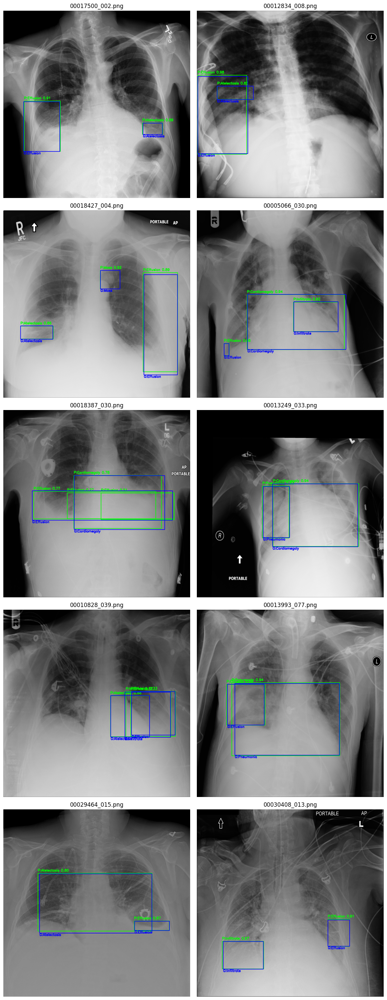

In [ ]:
import os
from ultralytics import YOLO
from tqdm import tqdm
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import numpy as np

# 경로 설정
label_dir = '/content/drive/MyDrive/bio/chest_project/datasets/val/labels'
image_dir = '/content/drive/MyDrive/bio/chest_project/datasets/val/images'

# 라벨 이름 정의 (YOLO 클래스 인덱스용)
class_names = [
    "Atelectasis", "Effusion", "Cardiomegaly", "Infiltrate",
    "Pneumonia", "Pneumothorax", "Mass", "Nodule"
]

# 중복 라벨이 있는 파일 수집
duplicated_label_files = []
for filename in os.listdir(label_dir):
    if filename.endswith(".txt"):
        file_path = os.path.join(label_dir, filename)
        with open(file_path, 'r') as f:
            if sum(1 for _ in f) > 1:
                duplicated_label_files.append(filename)

# 모델 로드
model = YOLO('/content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results16/weights/best.pt')
print(f"🧪 총 {len(duplicated_label_files)}개의 중복 라벨 이미지에 대해 예측을 수행합니다.\n")

# 예측 수행 및 시각화
visualization_images = []

for txt_file in tqdm(duplicated_label_files[:10], desc="Predicting"):
    image_filename = txt_file.replace(".txt", ".png")
    image_path = os.path.join(image_dir, image_filename)
    label_path = os.path.join(label_dir, txt_file)

    if not os.path.exists(image_path):
        continue

    # Load image
    img = Image.open(image_path).convert("RGB")
    img_cv = cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR)
    h, w = img_cv.shape[:2]

    # Predict
    results = model(image_path)
    r = results[0]
    boxes = r.boxes

    if len(boxes) == 0:
        continue

    # 1️⃣ 예측 결과 그리기 (녹색)
    for box in boxes:
        cls = int(box.cls)
        label = class_names[cls]
        conf = float(box.conf)
        x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
        cv2.rectangle(img_cv, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(img_cv, f"P:{label} {conf:.2f}", (x1, y1 - 10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

    # 2️⃣ 실제 라벨도 그리기 (파란색)
    with open(label_path, 'r') as f:
        for line in f:
            parts = line.strip().split()
            if len(parts) != 5:
                continue
            cls, xc, yc, bw, bh = map(float, parts)
            cls = int(cls)
            label = class_names[cls]

            # YOLO → pixel
            xc *= w
            yc *= h
            bw *= w
            bh *= h
            x1 = int(xc - bw / 2)
            y1 = int(yc - bh / 2)
            x2 = int(xc + bw / 2)
            y2 = int(yc + bh / 2)

            cv2.rectangle(img_cv, (x1, y1), (x2, y2), (255, 0, 0), 2)
            cv2.putText(img_cv, f"G:{label}", (x1, y2 + 15),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

    img_rgb = cv2.cvtColor(img_cv, cv2.COLOR_BGR2RGB)
    visualization_images.append((image_filename, img_rgb))

# 📸 시각화 (1행 2열)
cols = 2
rows = (len(visualization_images) + 1) // cols
plt.figure(figsize=(12, rows * 6))

for idx, (filename, img_rgb) in enumerate(visualization_images):
    plt.subplot(rows, cols, idx + 1)
    plt.imshow(img_rgb)
    plt.title(f"{filename}", fontsize=12)
    plt.axis("off")

plt.tight_layout()
plt.show()


🧪 총 32개의 중복 라벨 이미지에 대해 예측을 수행합니다.



Filtering for detection:   0%|          | 0/32 [00:00<?, ?it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00017500_002.png: 1024x1024 1 Atelectasis, 1 Effusion, 32.7ms
Speed: 4.5ms preprocess, 32.7ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


Filtering for detection:   3%|▎         | 1/32 [00:00<00:09,  3.39it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00012834_008.png: 1024x1024 1 Atelectasis, 1 Effusion, 32.8ms
Speed: 4.3ms preprocess, 32.8ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00018427_004.png: 1024x1024 1 Atelectasis, 1 Effusion, 1 Mass, 32.8ms
Speed: 5.9ms preprocess, 32.8ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


Filtering for detection:   9%|▉         | 3/32 [00:00<00:04,  6.94it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00005066_030.png: 1024x1024 1 Effusion, 1 Cardiomegaly, 1 Infiltrate, 32.8ms
Speed: 6.1ms preprocess, 32.8ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00018387_030.png: 1024x1024 3 Effusions, 1 Cardiomegaly, 32.7ms
Speed: 4.4ms preprocess, 32.7ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


Filtering for detection:  16%|█▌        | 5/32 [00:00<00:03,  8.40it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00013249_033.png: 1024x1024 1 Cardiomegaly, 1 Pneumonia, 29.2ms
Speed: 4.3ms preprocess, 29.2ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00010828_039.png: 1024x1024 1 Atelectasis, 1 Effusion, 1 Infiltrate, 29.2ms
Speed: 4.4ms preprocess, 29.2ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


Filtering for detection:  22%|██▏       | 7/32 [00:00<00:02,  9.83it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00013993_077.png: 1024x1024 1 Effusion, 1 Pneumonia, 29.2ms
Speed: 4.2ms preprocess, 29.2ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00029464_015.png: 1024x1024 1 Atelectasis, 1 Effusion, 29.2ms
Speed: 4.2ms preprocess, 29.2ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


Filtering for detection:  28%|██▊       | 9/32 [00:00<00:02, 10.63it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00030408_013.png: 1024x1024 1 Effusion, 1 Infiltrate, 29.2ms
Speed: 4.2ms preprocess, 29.2ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00020405_041.png: 1024x1024 1 Effusion, 1 Infiltrate, 29.2ms
Speed: 4.4ms preprocess, 29.2ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


Filtering for detection:  34%|███▍      | 11/32 [00:01<00:01, 10.98it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00013993_083.png: 1024x1024 1 Pneumonia, 29.2ms
Speed: 4.3ms preprocess, 29.2ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00011269_019.png: 1024x1024 1 Effusion, 1 Mass, 29.2ms
Speed: 5.5ms preprocess, 29.2ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


Filtering for detection:  41%|████      | 13/32 [00:01<00:01, 11.37it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00029502_006.png: 1024x1024 1 Atelectasis, 1 Effusion, 29.2ms
Speed: 4.4ms preprocess, 29.2ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00027479_013.png: 1024x1024 1 Effusion, 1 Infiltrate, 29.3ms
Speed: 6.3ms preprocess, 29.3ms inference, 2.3ms postprocess per image at shape (1, 3, 1024, 1024)


Filtering for detection:  47%|████▋     | 15/32 [00:01<00:01, 11.53it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00019018_007.png: 1024x1024 1 Cardiomegaly, 1 Infiltrate, 29.3ms
Speed: 5.4ms preprocess, 29.3ms inference, 1.9ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00020482_032.png: 1024x1024 1 Atelectasis, 1 Effusion, 1 Infiltrate, 29.3ms
Speed: 7.9ms preprocess, 29.3ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


Filtering for detection:  53%|█████▎    | 17/32 [00:01<00:01, 11.50it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00015069_001.png: 1024x1024 1 Infiltrate, 1 Pneumonia, 28.3ms
Speed: 7.4ms preprocess, 28.3ms inference, 2.0ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00018253_054.png: 1024x1024 1 Effusion, 1 Infiltrate, 28.4ms
Speed: 8.3ms preprocess, 28.4ms inference, 2.0ms postprocess per image at shape (1, 3, 1024, 1024)


Filtering for detection:  59%|█████▉    | 19/32 [00:01<00:01, 11.12it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00012505_007.png: 1024x1024 1 Effusion, 1 Infiltrate, 28.4ms
Speed: 7.3ms preprocess, 28.4ms inference, 2.2ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00027357_014.png: 1024x1024 1 Effusion, 1 Infiltrate, 28.3ms
Speed: 5.3ms preprocess, 28.3ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)


Filtering for detection:  66%|██████▌   | 21/32 [00:02<00:00, 11.28it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00010277_000.png: 1024x1024 1 Effusion, 1 Infiltrate, 1 Pneumonia, 1 Mass, 28.2ms
Speed: 5.3ms preprocess, 28.2ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00021201_010.png: 1024x1024 1 Infiltrate, 1 Mass, 28.3ms
Speed: 4.4ms preprocess, 28.3ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


Filtering for detection:  72%|███████▏  | 23/32 [00:02<00:00, 11.40it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00001836_082.png: 1024x1024 1 Atelectasis, 1 Mass, 28.3ms
Speed: 5.3ms preprocess, 28.3ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00025529_018.png: 1024x1024 1 Effusion, 1 Mass, 28.3ms
Speed: 7.2ms preprocess, 28.3ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)


Filtering for detection:  78%|███████▊  | 25/32 [00:02<00:00, 11.54it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00012021_081.png: 1024x1024 1 Infiltrate, 1 Pneumonia, 28.2ms
Speed: 5.4ms preprocess, 28.2ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00018393_000.png: 1024x1024 1 Infiltrate, 1 Pneumonia, 28.3ms
Speed: 7.0ms preprocess, 28.3ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


Filtering for detection:  84%|████████▍ | 27/32 [00:02<00:00, 11.94it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00029431_000.png: 1024x1024 1 Infiltrate, 1 Pneumonia, 28.3ms
Speed: 4.1ms preprocess, 28.3ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00016705_006.png: 1024x1024 1 Infiltrate, 1 Pneumonia, 28.3ms
Speed: 7.1ms preprocess, 28.3ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


Filtering for detection:  91%|█████████ | 29/32 [00:02<00:00, 11.73it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00018366_029.png: 1024x1024 1 Effusion, 1 Pneumothorax, 28.2ms
Speed: 5.2ms preprocess, 28.2ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00008841_025.png: 1024x1024 1 Effusion, 1 Pneumothorax, 28.2ms
Speed: 5.1ms preprocess, 28.2ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)


Filtering for detection:  97%|█████████▋| 31/32 [00:02<00:00, 12.04it/s]


image 1/1 /content/drive/MyDrive/bio/chest_project/datasets/val/images/00016837_002.png: 1024x1024 1 Atelectasis, 1 Effusion, 26.6ms
Speed: 5.2ms preprocess, 26.6ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


Filtering for detection: 100%|██████████| 32/32 [00:02<00:00, 10.93it/s]


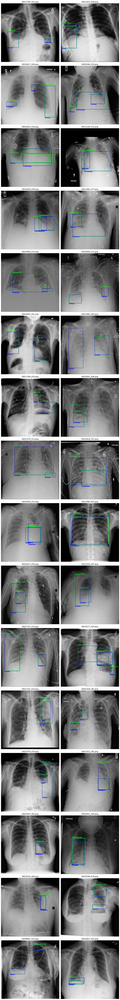

In [ ]:
import os
from ultralytics import YOLO
from tqdm import tqdm
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import numpy as np

# 경로 설정
label_dir = '/content/drive/MyDrive/bio/chest_project/datasets/val/labels'
image_dir = '/content/drive/MyDrive/bio/chest_project/datasets/val/images'

# YOLO 라벨 이름
class_names = [
    "Atelectasis", "Effusion", "Cardiomegaly", "Infiltrate",
    "Pneumonia", "Pneumothorax", "Mass", "Nodule"
]

# 1️⃣ 중복 라벨 있는 파일 목록 수집
duplicated_label_files = []
for filename in os.listdir(label_dir):
    if filename.endswith(".txt"):
        file_path = os.path.join(label_dir, filename)
        with open(file_path, 'r') as f:
            if sum(1 for _ in f) > 1:
                duplicated_label_files.append(filename)

# 2️⃣ 모델 로드
model = YOLO('/content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results16/weights/best.pt')
print(f"🧪 총 {len(duplicated_label_files)}개의 중복 라벨 이미지에 대해 예측을 수행합니다.\n")

# 3️⃣ 예측 있는 이미지만 시각화용으로 수집
visualization_images = []

for txt_file in tqdm(duplicated_label_files, desc="Filtering for detection"):
    image_filename = txt_file.replace(".txt", ".png")
    image_path = os.path.join(image_dir, image_filename)
    label_path = os.path.join(label_dir, txt_file)

    if not os.path.exists(image_path):
        continue

    results = model(image_path)
    r = results[0]
    boxes = r.boxes

    if len(boxes) == 0:
        continue  # 예측 없으면 시각화 생략

    # 이미지 로드 및 변환
    img = Image.open(image_path).convert("RGB")
    img_cv = cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR)
    h, w = img_cv.shape[:2]

    # 4️⃣ 예측 박스 그리기 (녹색)
    for box in boxes:
        cls = int(box.cls)
        label = class_names[cls]
        conf = float(box.conf)
        x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
        cv2.rectangle(img_cv, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(img_cv, f"P:{label} {conf:.2f}", (x1, y1 - 10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

    # 5️⃣ 실제 정답 박스 그리기 (파란색)
    with open(label_path, 'r') as f:
        for line in f:
            parts = line.strip().split()
            if len(parts) != 5:
                continue
            cls, xc, yc, bw, bh = map(float, parts)
            cls = int(cls)
            label = class_names[cls]

            # YOLO → pixel 좌표
            xc *= w
            yc *= h
            bw *= w
            bh *= h
            x1 = int(xc - bw / 2)
            y1 = int(yc - bh / 2)
            x2 = int(xc + bw / 2)
            y2 = int(yc + bh / 2)

            cv2.rectangle(img_cv, (x1, y1), (x2, y2), (255, 0, 0), 2)
            cv2.putText(img_cv, f"G:{label}", (x1, y2 + 15),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

    img_rgb = cv2.cvtColor(img_cv, cv2.COLOR_BGR2RGB)
    visualization_images.append((image_filename, img_rgb))

# 6️⃣ 시각화 (1행 2열씩 배치)
cols = 2
rows = (len(visualization_images) + 1) // cols
plt.figure(figsize=(12, rows * 6))

for idx, (filename, img_rgb) in enumerate(visualization_images):
    plt.subplot(rows, cols, idx + 1)
    plt.imshow(img_rgb)
    plt.title(f"{filename}", fontsize=12)
    plt.axis("off")

plt.tight_layout()
plt.show()


# grad-cam

In [ ]:
# !pip install grad-cam --upgrade
# !pip install -U pytorch-grad-cam

In [ ]:
import torch
from ultralytics import YOLO

class YOLOModelExplorer:
    def __init__(self, model_path):
        self.model = YOLO(model_path).model

    def print_named_modules(self):
        print("📦 YOLOv8 전체 네임드 모듈 구조:")
        for name, module in self.model.named_modules():
            print(f"{name:<30} → {module.__class__.__name__}")

    def print_model_blocks(self):
        print("🔍 YOLOv8 .model[n] 블록 구조:")
        for idx, layer in enumerate(self.model):
            layer_type = layer.__class__.__name__
            layer_summary = str(layer).split('\n')[0]
            print(f"[{idx:2d}] {layer_type:<20} → {layer_summary}")

    def get_layer_by_index(self, index: int):
        """특정 인덱스의 레이어 반환"""
        return self.model[index]

    def get_layer_by_name(self, name: str):
        """네임드 모듈 접근"""
        return dict(self.model.named_modules()).get(name, None)


In [ ]:
# 모델 로드
explorer = YOLOModelExplorer('/content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results9/weights/best.pt')

# 전체 레이어 이름 확인
explorer.print_named_modules()


📦 YOLOv8 전체 네임드 모듈 구조:
                               → DetectionModel
model                          → Sequential
model.0                        → Conv
model.0.conv                   → Conv2d
model.0.bn                     → BatchNorm2d
model.0.act                    → SiLU
model.1                        → Conv
model.1.conv                   → Conv2d
model.1.bn                     → BatchNorm2d
model.2                        → C2f
model.2.cv1                    → Conv
model.2.cv1.conv               → Conv2d
model.2.cv1.bn                 → BatchNorm2d
model.2.cv2                    → Conv
model.2.cv2.conv               → Conv2d
model.2.cv2.bn                 → BatchNorm2d
model.2.m                      → ModuleList
model.2.m.0                    → Bottleneck
model.2.m.0.cv1                → Conv
model.2.m.0.cv1.conv           → Conv2d
model.2.m.0.cv1.bn             → BatchNorm2d
model.2.m.0.cv2                → Conv
model.2.m.0.cv2.conv           → Conv2d
model.2.m.0.cv2.bn           

| Layer Name | 설명                             |
| ---------- | ------------------------------ |
| `model.6`  | 중간 backbone 특징                 |
| `model.8`  | 마지막 backbone block             |
| `model.12` | neck 초기 결합 특징                  |
| `model.15` | neck 중간 block, spatial 보존 좋음   |
| `model.18` | neck 마지막 block, 약간 더 추상화됨      |
| `model.21` | decode 직전, Grad-CAM이 평탄해질 수 있음 |



🧪 총 32개의 중복 라벨 이미지에 대해 Grad-CAM을 적용합니다.



Generating Grad-CAM: 100%|██████████| 6/6 [00:00<00:00,  7.88it/s]


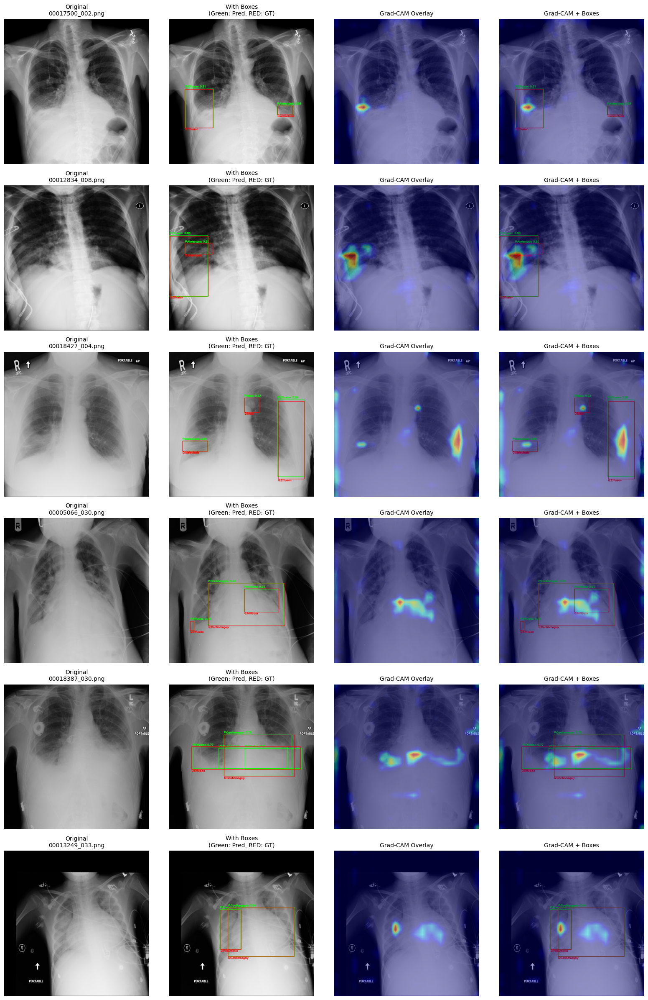

In [ ]:
import os
import torch
from ultralytics import YOLO
import cv2
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt


class YOLOGradCAM:
    def __init__(self, model_path, target_layer_name='model.21'):
        self.model = YOLO(model_path)
        self.target_layer_name = target_layer_name
        self.gradients = None
        self.activations = None
        self.hooks = []

    def _get_target_layer(self):
        for name, module in self.model.model.named_modules():
            if name == self.target_layer_name:
                return module

        conv_layers = [(name, module) for name, module in self.model.model.named_modules()
                       if isinstance(module, torch.nn.Conv2d)]

        if conv_layers:
            print(f"타겟 레이어를 찾을 수 없어 마지막 Conv 레이어 사용: {conv_layers[-1][0]}")
            return conv_layers[-1][1]

        raise ValueError("적절한 타겟 레이어를 찾을 수 없습니다.")

    def _save_activation(self, module, input, output):
        """활성화 저장"""
        if isinstance(output, tuple):
            self.activations = output[0]
        else:
            self.activations = output


    def _register_hooks(self):
        target_layer = self._get_target_layer()
        forward_hook = target_layer.register_forward_hook(self._save_activation)
        self.hooks.append(forward_hook)

    def _remove_hooks(self):
        for hook in self.hooks:
            hook.remove()
        self.hooks = []

    def generate_gradcam(self, image_path, box_idx=0):
        self._register_hooks()
        try:
            original_image = cv2.imread(image_path)
            original_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)
            results = self.model(image_path, verbose=False)

            if len(results[0].boxes) == 0:
                print("예측된 박스가 없습니다.")
                return None, original_image, results[0]

            boxes = results[0].boxes
            if box_idx >= len(boxes):
                box_idx = 0

            if self.activations is not None:
                activations = self.activations.squeeze(0).cpu().numpy()  # [C, H, W]
                heatmap = np.mean(activations, axis=0)
                heatmap = np.maximum(heatmap, 0)
                if heatmap.max() > 0:
                    heatmap = heatmap / heatmap.max()

                heatmap_resized = cv2.resize(heatmap, (original_image.shape[1], original_image.shape[0]))
                return heatmap_resized, original_image, results[0]
            else:
                print("활성화를 캡처하지 못했습니다.")
                return None, original_image, results[0]
        except Exception as e:
            print(f"Grad-CAM 생성 중 오류: {e}")
            return None, original_image if 'original_image' in locals() else None, None
        finally:
            self._remove_hooks()


def apply_gradcam_overlay(image, heatmap, alpha=0.4, colormap=cv2.COLORMAP_JET):
    heatmap_uint8 = (heatmap * 255).astype(np.uint8)
    heatmap_colored = cv2.applyColorMap(heatmap_uint8, colormap)
    heatmap_colored = cv2.cvtColor(heatmap_colored, cv2.COLOR_BGR2RGB)
    overlayed = cv2.addWeighted(image, 1 - alpha, heatmap_colored, alpha, 0)
    return overlayed


if __name__ == "__main__":
    label_dir = '/content/drive/MyDrive/bio/chest_project/datasets/val/labels'
    image_dir = '/content/drive/MyDrive/bio/chest_project/datasets/val/images'
    model_path = '/content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results16/weights/best.pt'

    class_names = [
        "Atelectasis", "Effusion", "Cardiomegaly", "Infiltrate",
        "Pneumonia", "Pneumothorax", "Mass", "Nodule"
    ]

    gradcam = YOLOGradCAM(model_path)

    duplicated_label_files = [f for f in os.listdir(label_dir)
                              if f.endswith(".txt") and sum(1 for _ in open(os.path.join(label_dir, f))) > 1]

    print(f"\n🧪 총 {len(duplicated_label_files)}개의 중복 라벨 이미지에 대해 Grad-CAM을 적용합니다.\n")

    visualization_images = []

    for txt_file in tqdm(duplicated_label_files[:6], desc="Generating Grad-CAM"):
        image_filename = txt_file.replace(".txt", ".png")
        image_path = os.path.join(image_dir, image_filename)
        label_path = os.path.join(label_dir, txt_file)

        if not os.path.exists(image_path):
            continue

        heatmap, original_image, predictions = gradcam.generate_gradcam(image_path)

        if heatmap is None or original_image is None:
            continue

        if len(predictions.boxes) == 0:
            continue

        img_with_boxes = original_image.copy()
        h, w = img_with_boxes.shape[:2]

        for box in predictions.boxes:
            cls = int(box.cls)
            label = class_names[cls]
            conf = float(box.conf)
            x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
            cv2.rectangle(img_with_boxes, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(img_with_boxes, f"P:{label} {conf:.2f}", (x1, y1 - 10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

        with open(label_path, 'r') as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) != 5:
                    continue
                cls, xc, yc, bw, bh = map(float, parts)
                cls = int(cls)
                label = class_names[cls]

                xc *= w
                yc *= h
                bw *= w
                bh *= h
                x1 = int(xc - bw / 2)
                y1 = int(yc - bh / 2)
                x2 = int(xc + bw / 2)
                y2 = int(yc + bh / 2)

                cv2.rectangle(img_with_boxes, (x1, y1), (x2, y2), (255, 0, 0), 2)
                cv2.putText(img_with_boxes, f"G:{label}", (x1, y2 + 15),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

        gradcam_overlay = apply_gradcam_overlay(original_image, heatmap)
        gradcam_overlay_with_boxes = apply_gradcam_overlay(img_with_boxes, heatmap)

        visualization_images.append({
            'filename': image_filename,
            'original': original_image,
            'with_boxes': img_with_boxes,
            'gradcam_overlay': gradcam_overlay,
            'gradcam_with_boxes': gradcam_overlay_with_boxes,
            'heatmap': heatmap
        })

    if visualization_images:
        fig, axes = plt.subplots(len(visualization_images), 4, figsize=(16, 4 * len(visualization_images)))
        if len(visualization_images) == 1:
            axes = axes.reshape(1, -1)

        for i, img_data in enumerate(visualization_images):
            axes[i, 0].imshow(img_data['original'])
            axes[i, 0].set_title(f"Original\n{img_data['filename']}", fontsize=10)
            axes[i, 0].axis('off')

            axes[i, 1].imshow(img_data['with_boxes'])
            axes[i, 1].set_title("With Boxes\n(Green: Pred, RED: GT)", fontsize=10)
            axes[i, 1].axis('off')

            axes[i, 2].imshow(img_data['gradcam_overlay'])
            axes[i, 2].set_title("Grad-CAM Overlay", fontsize=10)
            axes[i, 2].axis('off')

            axes[i, 3].imshow(img_data['gradcam_with_boxes'])
            axes[i, 3].set_title("Grad-CAM + Boxes", fontsize=10)
            axes[i, 3].axis('off')

        plt.tight_layout()
        plt.show()
    else:
        print("시각화할 이미지가 없습니다.")


🧪 총 32개의 중복 라벨 이미지에 대해 Grad-CAM을 적용합니다.



Generating Grad-CAM:  83%|████████▎ | 5/6 [00:02<00:00,  1.81it/s]

예측된 박스가 없습니다.


Generating Grad-CAM: 100%|██████████| 6/6 [00:03<00:00,  1.73it/s]



📷 Image: 00017500_002.png
🟩 Predicted Labels: ['Atelectasis', 'Effusion']
🟥 Ground Truth Labels: ['Atelectasis', 'Effusion']

📷 Image: 00012834_008.png
🟩 Predicted Labels: ['Effusion', 'Atelectasis']
🟥 Ground Truth Labels: ['Atelectasis', 'Effusion']

📷 Image: 00018427_004.png
🟩 Predicted Labels: ['Mass', 'Atelectasis', 'Effusion', 'Effusion']
🟥 Ground Truth Labels: ['Atelectasis', 'Effusion', 'Mass']

📷 Image: 00005066_030.png
🟩 Predicted Labels: ['Infiltrate', 'Cardiomegaly', 'Effusion', 'Effusion', 'Effusion']
🟥 Ground Truth Labels: ['Cardiomegaly', 'Effusion', 'Infiltrate']

📷 Image: 00013249_033.png
🟩 Predicted Labels: ['Cardiomegaly', 'Pneumonia', 'Infiltrate']
🟥 Ground Truth Labels: ['Cardiomegaly', 'Pneumonia']


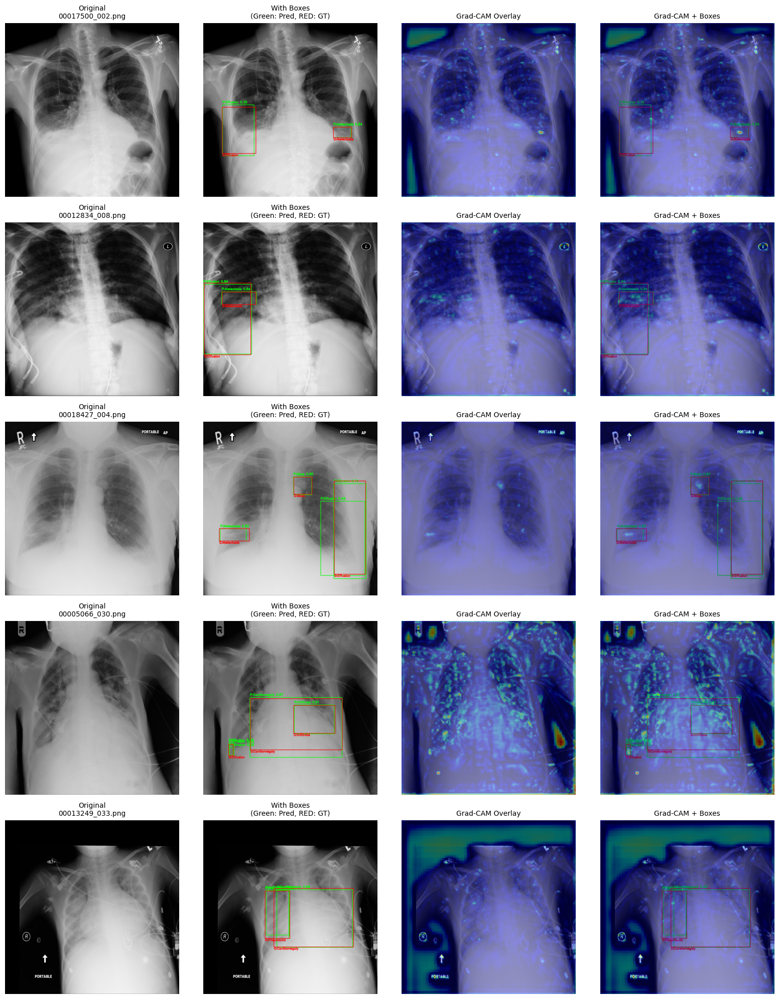

In [ ]:
import os
import torch
from ultralytics import YOLO
import cv2
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt


class YOLOGradCAM:
    def __init__(self, model_path, target_layer_name='model.15'):
        self.model = YOLO(model_path)
        self.target_layer_name = target_layer_name
        self.gradients = None
        self.activations = None
        self.hooks = []

    def _get_target_layer(self):
        for name, module in self.model.model.named_modules():
            if name == self.target_layer_name:
                return module

        conv_layers = [(name, module) for name, module in self.model.model.named_modules()
                       if isinstance(module, torch.nn.Conv2d)]

        if conv_layers:
            print(f"타겟 레이어를 찾을 수 없어 마지막 Conv 레이어 사용: {conv_layers[-1][0]}")
            return conv_layers[-1][1]

        raise ValueError("적절한 타겟 레이어를 찾을 수 없습니다.")

    def _save_activation(self, module, input, output):
        if isinstance(output, tuple):
            self.activations = output[0]
        else:
            self.activations = output

    def _register_hooks(self):
        target_layer = self._get_target_layer()
        forward_hook = target_layer.register_forward_hook(self._save_activation)
        self.hooks.append(forward_hook)

    def _remove_hooks(self):
        for hook in self.hooks:
            hook.remove()
        self.hooks = []

    def generate_gradcam(self, image_path, box_idx=0):
        self._register_hooks()
        try:
            original_image = cv2.imread(image_path)
            original_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)
            results = self.model(image_path, verbose=False)

            if len(results[0].boxes) == 0:
                print("예측된 박스가 없습니다.")
                return None, original_image, results[0]

            boxes = results[0].boxes
            if box_idx >= len(boxes):
                box_idx = 0

            if self.activations is not None:
                activations = self.activations.squeeze(0).cpu().numpy()
                heatmap = np.mean(activations, axis=0)
                heatmap = np.maximum(heatmap, 0)
                if heatmap.max() > 0:
                    heatmap = heatmap / heatmap.max()

                heatmap_resized = cv2.resize(heatmap, (original_image.shape[1], original_image.shape[0]))
                return heatmap_resized, original_image, results[0]
            else:
                print("활성화를 캡처하지 못했습니다.")
                return None, original_image, results[0]
        except Exception as e:
            print(f"Grad-CAM 생성 중 오류: {e}")
            return None, original_image if 'original_image' in locals() else None, None
        finally:
            self._remove_hooks()


def apply_gradcam_overlay(image, heatmap, alpha=0.4, colormap=cv2.COLORMAP_JET):
    heatmap_uint8 = (heatmap * 255).astype(np.uint8)
    heatmap_colored = cv2.applyColorMap(heatmap_uint8, colormap)
    heatmap_colored = cv2.cvtColor(heatmap_colored, cv2.COLOR_BGR2RGB)
    overlayed = cv2.addWeighted(image, 1 - alpha, heatmap_colored, alpha, 0)
    return overlayed


if __name__ == "__main__":
    label_dir = '/content/drive/MyDrive/bio/chest_project/datasets/val/labels'
    image_dir = '/content/drive/MyDrive/bio/chest_project/datasets/val/images'
    model_path = '/content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results10/weights/best.pt'

    class_names = [
        "Atelectasis", "Effusion", "Cardiomegaly", "Infiltrate",
        "Pneumonia", "Pneumothorax", "Mass", "Nodule"
    ]

    gradcam = YOLOGradCAM(model_path)

    duplicated_label_files = [f for f in os.listdir(label_dir)
                              if f.endswith(".txt") and sum(1 for _ in open(os.path.join(label_dir, f))) > 1]

    print(f"\n🧪 총 {len(duplicated_label_files)}개의 중복 라벨 이미지에 대해 Grad-CAM을 적용합니다.\n")

    visualization_images = []

    for txt_file in tqdm(duplicated_label_files[:6], desc="Generating Grad-CAM"):
        image_filename = txt_file.replace(".txt", ".png")
        image_path = os.path.join(image_dir, image_filename)
        label_path = os.path.join(label_dir, txt_file)

        if not os.path.exists(image_path):
            continue

        heatmap, original_image, predictions = gradcam.generate_gradcam(image_path)

        if heatmap is None or original_image is None:
            continue

        if len(predictions.boxes) == 0:
            continue

        img_with_boxes = original_image.copy()
        h, w = img_with_boxes.shape[:2]

        pred_labels = []
        gt_labels = []

        for box in predictions.boxes:
            cls = int(box.cls)
            label = class_names[cls]
            pred_labels.append(label)
            conf = float(box.conf)
            x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
            cv2.rectangle(img_with_boxes, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(img_with_boxes, f"P:{label} {conf:.2f}", (x1, y1 - 10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

        with open(label_path, 'r') as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) != 5:
                    continue
                cls, xc, yc, bw, bh = map(float, parts)
                cls = int(cls)
                label = class_names[cls]
                gt_labels.append(label)

                xc *= w
                yc *= h
                bw *= w
                bh *= h
                x1 = int(xc - bw / 2)
                y1 = int(yc - bh / 2)
                x2 = int(xc + bw / 2)
                y2 = int(yc + bh / 2)

                cv2.rectangle(img_with_boxes, (x1, y1), (x2, y2), (255, 0, 0), 2)
                cv2.putText(img_with_boxes, f"G:{label}", (x1, y2 + 15),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

        gradcam_overlay = apply_gradcam_overlay(original_image, heatmap)
        gradcam_overlay_with_boxes = apply_gradcam_overlay(img_with_boxes, heatmap)

        visualization_images.append({
            'filename': image_filename,
            'original': original_image,
            'with_boxes': img_with_boxes,
            'gradcam_overlay': gradcam_overlay,
            'gradcam_with_boxes': gradcam_overlay_with_boxes,
            'heatmap': heatmap,
            'pred_labels': pred_labels,
            'gt_labels': gt_labels
        })

    if visualization_images:
        fig, axes = plt.subplots(len(visualization_images), 4, figsize=(16, 4 * len(visualization_images)))
        if len(visualization_images) == 1:
            axes = axes.reshape(1, -1)

        for i, img_data in enumerate(visualization_images):
            axes[i, 0].imshow(img_data['original'])
            axes[i, 0].set_title(f"Original\n{img_data['filename']}", fontsize=10)
            axes[i, 0].axis('off')

            axes[i, 1].imshow(img_data['with_boxes'])
            axes[i, 1].set_title("With Boxes\n(Green: Pred, RED: GT)", fontsize=10)
            axes[i, 1].axis('off')

            axes[i, 2].imshow(img_data['gradcam_overlay'])
            axes[i, 2].set_title("Grad-CAM Overlay", fontsize=10)
            axes[i, 2].axis('off')

            axes[i, 3].imshow(img_data['gradcam_with_boxes'])
            axes[i, 3].set_title("Grad-CAM + Boxes", fontsize=10)
            axes[i, 3].axis('off')

            # 텍스트 출력
            print(f"\n📷 Image: {img_data['filename']}")
            print(f"🟩 Predicted Labels: {img_data['pred_labels']}")
            print(f"🟥 Ground Truth Labels: {img_data['gt_labels']}")

        plt.tight_layout()
        plt.show()
    else:
        print("시각화할 이미지가 없습니다.")



🧪 총 13개의 검출 성공 이미지에 대해 Grad-CAM을 적용합니다.



Generating Grad-CAM:  83%|████████▎ | 5/6 [00:02<00:00,  1.87it/s]

예측된 박스가 없습니다.


Generating Grad-CAM: 100%|██████████| 6/6 [00:03<00:00,  1.79it/s]


📷 Image: 00018427_004.png
🟩 Predicted Labels     : Mass, Atelectasis, Effusion, Effusion
🟥 Ground Truth Labels : Atelectasis, Effusion, Mass
📷 Image: 00005066_030.png
🟩 Predicted Labels     : Infiltrate, Cardiomegaly, Effusion, Effusion, Effusion
🟥 Ground Truth Labels : Cardiomegaly, Effusion, Infiltrate
📷 Image: 00013249_033.png
🟩 Predicted Labels     : Cardiomegaly, Pneumonia, Infiltrate
🟥 Ground Truth Labels : Cardiomegaly, Pneumonia
📷 Image: 00020405_041.png
🟩 Predicted Labels     : Infiltrate, Effusion, Effusion
🟥 Ground Truth Labels : Effusion, Infiltrate
📷 Image: 00019018_007.png
🟩 Predicted Labels     : Infiltrate, Cardiomegaly
🟥 Ground Truth Labels : Cardiomegaly, Infiltrate


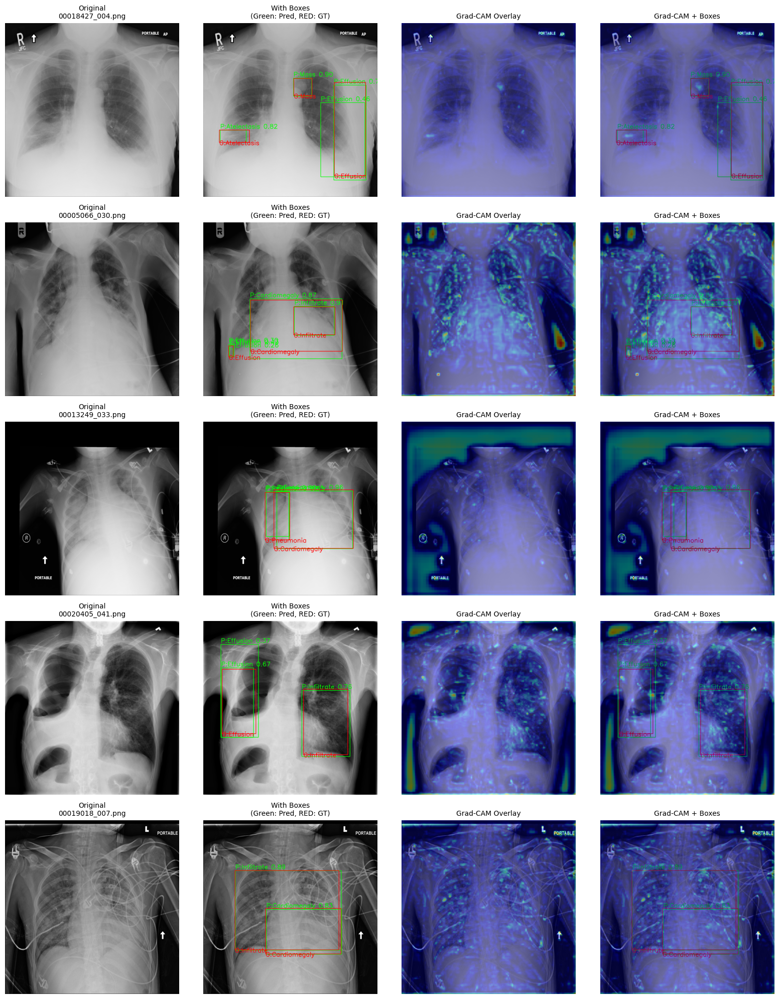

In [ ]:
if __name__ == "__main__":
    label_dir = '/content/drive/MyDrive/bio/chest_project/datasets/val/labels'
    image_dir = '/content/drive/MyDrive/bio/chest_project/datasets/val/images'
    model_path = '/content/drive/MyDrive/bio/chest_project/chest_yolo/v8_results10/weights/best.pt'
    detected_txt_path = '/content/drive/MyDrive/bio/chest_project/detected_images.txt'

    class_names = [
        "Atelectasis", "Effusion", "Cardiomegaly", "Infiltrate",
        "Pneumonia", "Pneumothorax", "Mass", "Nodule"
    ]

    gradcam = YOLOGradCAM(model_path)

    # 📄 저장된 이미지 목록 로드
    with open(detected_txt_path, 'r') as f:
        detected_images = [line.strip() for line in f.readlines() if line.strip().endswith('.png')]

    print(f"\n🧪 총 {len(detected_images)}개의 검출 성공 이미지에 대해 Grad-CAM을 적용합니다.\n")

    visualization_images = []

    for image_filename in tqdm(detected_images[:6], desc="Generating Grad-CAM"):
        image_path = os.path.join(image_dir, image_filename)
        label_path = os.path.join(label_dir, image_filename.replace(".png", ".txt"))

        if not os.path.exists(image_path) or not os.path.exists(label_path):
            print(f"❌ 누락된 경로: {image_path} 또는 {label_path}")
            continue

        heatmap, original_image, predictions = gradcam.generate_gradcam(image_path)

        if heatmap is None or original_image is None or len(predictions.boxes) == 0:
            continue

        img_with_boxes = original_image.copy()
        h, w = img_with_boxes.shape[:2]

        pred_labels = []
        gt_labels = []

        # ✅ 예측 박스 (초록)
        for box in predictions.boxes:
            cls = int(box.cls)
            label = class_names[cls]
            pred_labels.append(label)
            conf = float(box.conf)
            x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
            cv2.rectangle(img_with_boxes, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(img_with_boxes, f"P:{label} {conf:.2f}", (x1, y1 - 10),
                        cv2.FONT_HERSHEY_SIMPLEX, 1.2, (0, 255, 0), 2)

        # ✅ GT 박스 (빨강)
        with open(label_path, 'r') as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) != 5:
                    continue
                cls, xc, yc, bw, bh = map(float, parts)
                cls = int(cls)
                label = class_names[cls]
                gt_labels.append(label)

                xc *= w
                yc *= h
                bw *= w
                bh *= h
                x1 = int(xc - bw / 2)
                y1 = int(yc - bh / 2)
                x2 = int(xc + bw / 2)
                y2 = int(yc + bh / 2)
                cv2.rectangle(img_with_boxes, (x1, y1), (x2, y2), (255, 0, 0), 2)
                cv2.putText(img_with_boxes, f"G:{label}", (x1, y2 + 15),
                            cv2.FONT_HERSHEY_SIMPLEX, 1.2, (255, 0, 0), 2)

        gradcam_overlay = apply_gradcam_overlay(original_image, heatmap)
        gradcam_overlay_with_boxes = apply_gradcam_overlay(img_with_boxes, heatmap)

        visualization_images.append({
            'filename': image_filename,
            'original': original_image,
            'with_boxes': img_with_boxes,
            'gradcam_overlay': gradcam_overlay,
            'gradcam_with_boxes': gradcam_overlay_with_boxes,
            'heatmap': heatmap,
            'pred_labels': pred_labels,
            'gt_labels': gt_labels
        })


    # 📊 시각화
    if visualization_images:
        fig, axes = plt.subplots(len(visualization_images), 4, figsize=(16, 4 * len(visualization_images)))
        if len(visualization_images) == 1:
            axes = axes.reshape(1, -1)

        for i, img_data in enumerate(visualization_images):
            axes[i, 0].imshow(img_data['original'])
            axes[i, 0].set_title(f"Original\n{img_data['filename']}", fontsize=10)
            axes[i, 0].axis('off')

            axes[i, 1].imshow(img_data['with_boxes'])
            axes[i, 1].set_title("With Boxes\n(Green: Pred, RED: GT)", fontsize=10)
            axes[i, 1].axis('off')

            axes[i, 2].imshow(img_data['gradcam_overlay'])
            axes[i, 2].set_title("Grad-CAM Overlay", fontsize=10)
            axes[i, 2].axis('off')

            axes[i, 3].imshow(img_data['gradcam_with_boxes'])
            axes[i, 3].set_title("Grad-CAM + Boxes", fontsize=10)
            axes[i, 3].axis('off')

            # 🎯 원하는 출력 방식: 각 이미지 row마다 아래에 라벨 정보 출력
            print("=" * 80)
            print(f"📷 Image: {img_data['filename']}")
            print(f"🟩 Predicted Labels     : {', '.join(img_data['pred_labels']) if img_data['pred_labels'] else 'None'}")
            print(f"🟥 Ground Truth Labels : {', '.join(img_data['gt_labels']) if img_data['gt_labels'] else 'None'}")

        plt.tight_layout()
        plt.show()


    else:
        print("시각화할 이미지가 없습니다.")
